## **① 문제상황**
---
> **시나리오** 🏭

```
'반도체 공정 이상 탐지' 프로젝트 팀은 반도체 제조의 복잡한 프로세스에 대한 새로운 프로젝트를 맡게 되었습니다. 이 프로젝트는 센서와 설비에서
수집된 다양한 신호와 변수들을 세심하게 모니터링하는 일로부터 시작됩니다. 이 신호들이 모두 동일한 중요성을 가지는 것은 아니라는 점이 현업이
요구한 내용의 핵심이며 우리 팀이 풀어가야하는 핵심문제입니다.

우리가 분석할 데이터는 유용한 정보, 관련 없는 정보, 그리고 잡음이 혼합돼 복잡합니다. 우리에게는 실제로 필요한 것보다 많은 신호들이 주어져 있으며,
일반적으로 엔지니어들은 각각의 신호 유형을 하나의 독특한 특성으로 보고 접근합니다. Feature Engineering(특성 선택 기법)을 적용하여,
우리는 가장 관련성 높은 신호들을 선별해 내며, 이러한 신호들을 활용해 공정에서 발생할 수 있는 수율 이탈의 주요 원인들을 파악하려 합니다.

이 과정은 공정의 효율성을 향상시키고, 생산 비용을 절감할 수 있는 다양한 인사이트를 제공할 수 있을 것이라 기대됩니다. 이 신호들은 또한
반도체의 생산의 Pass/Fail 을 예측하는 데 사용될 수 있는 귀중한 특성으로 활용됩니다. 다양한 특성 조합을 탐색하고 실험함으로써,
우리는 수율 유형에 중대한 영향을 미치는 핵심 신호들을 식별할 수 있습니다.

정리하자면 우리 팀의 목표는 바로 반도체 공정 프로세스의 합격/불합격 수율을 예측할 수 있는 가장 의미 있는 신호를 찾아내고,
반도체 제조 과정의 품질과 효율성을 한 단계 끌어올리는 것입니다.

```

## **② 분석목표 및 예상 결과물**
---
> **분석목표**

```
1. 센서 데이터로부터 반도체 공정의 Pass/Fail을 식별하기 위한 중요 변수 도출
```

> **예상 결과물**

```
1. 데이터 분석 기획서 (과제요건서)
2. Data Analysis 단계별 코드
3. 중요변수 도출
```

## **③ 과제요건서 작성**
---

<img src = "https://drive.google.com/uc?id=1A1Sz35J1jButl8y4bu2Fj4-ahkKFUAvo">

> **문제정의**

```
▶ 반도체 공정 프로세스 불합격으로 영업 이익 감소
    - 반도체 공정 프로세스로 인해 불량 제품 생상 증가 및 폐기 비용 증가
    - 고객사 이탈
        - 최소 수율 미달: 경쟁사 대비 수율 경쟁력 약화로 고객사 이탈
        - 영업 이익 감소: 고객사 감소로 인한 매출 감소
        - 브랜드 이미지 손상: 낮은 수율로 인한 제품 불량률 증가, 브랜드 이미지 및 고객 신뢰도 하락
        - 시장 점유율 감소: 경쟁사에 시장 점유율을 빼앗겨 시장 지위 약화
    - 생산 비용 증가
        - 불량 제품 생산 증가: 수율 감소로 인한 불량 제품 증가, 재작업 및 폐기 비용 증가
```  
https://www.hankyung.com/article/202304265147i  

> **기대효과**

```
▶ 반도체 공정 프로세스 문제 해결을 통한 기대효과
    - 생산 효율성 향상
        - 재작업 및 폐기 비용 수십억원 감소
        - 생산 공정 최적화 및 설비 활용도 향상

```

> **해결방안**

```
▶ 반도체 공정 프로세스 합격/불합격 수율 향상을 위한 해결 방안
    - 데이터 탐색 및 데이터 전처리
    - 차원 축소 기법/변수 선택법 및 Feature Engineering
    - 이상치 탐지 모델을 통해 반도체 공정 합격/불합격 판단
```

> **우선순위**  

```
▶ 해결 방안에서 사용할 우선순위 작성
    - 1순위: 데이터 탐색 및 전처리
    - 2순위: 결측치 확인 및 처리
    - 3순위: scaling 및 변수 선택
    - 4순위: 이상탐지 모델 적용
        - IsolationForest
        - XGBOD
```

> **데이터 분석**  

```
1. 결측치 확인 후 이상치 여부 확인
    - 이상치가 존재할 때 MICE를 활용해 결측치 대체
    - 이상치가 존재하지 않을 때 최빈값을 이용해 대체

2. 변수들의 scale을 맞추기 위해 데이터 정규화 실시
    - 이상치가 존재할 때 사분위를 활용한 RobustScaler 사용
    - 이상치가 존재하지 않을 때 StandardScaler 사용

3. 모델을 활용한 중요 feature 추출
    - Logistic 회귀의 Information Value 사용
    - RandomForeset의 Feature Importance 활용

4. 이상탐지 모델 적합
    - IsolationForest
    - XGBOD
```

> **성과측정**  

```
▶ 성과 측정
    - confusion matrix를 활용해 AUC, F1-score 확인
    - 데이터를 5개의 fold를 나눠 모델의 평균 성능 확인

```

> **모델 운영**  

```
▶ 모델 운영 방안
    - 일: 초 단위 데이터를 활용해 이상치 여부 파악
    - 주: 주간 데이터를 활용해 몇 번째 공정에서 얼마나 Fail이 나타났는지 비율 파악
    - 월: 월 별 데이터를 활용해 parameter tuning
    - 이상치 발견시 공정의 베태랑 전문가에게 조언을 받아 제거 여부 파악

```



In [ ]:
# ▶ Warnings 제거
import warnings
warnings.filterwarnings('ignore')

# ▶ Google drive mount or 폴더 클릭 후 구글드라이브 연결
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

# ▶ 경로 설정 (※ Colab을 활성화시켰다면 보통 Colab Notebooks 폴더가 자동 생성)
import os
os.chdir("/content/drive/MyDrive/DS/Manufacture")
os.getcwd()

Mounted at /content/drive


'/content/drive/MyDrive/DS/Manufacture'

In [ ]:
!sudo apt-get install -y fonts-nanum
!sudo fc-cache -fv
!rm ~/.cache/matplotlib -rf

## **🌼 Data Analysis 1단계**  
**┗ 데이터 Info Check**  
---
```
수집된 데이터의 기본 정보들을 확인하고, 이상이 있을 시 전처리 수행

  (1) Data shape(형태) 확인

  (2) Data type 확인

  (3) Null값/Constant(상수) 값 확인 (※ 빈 값의 Data)

  (4) Outlier 확인 (※ 정상적인 범주를 벗어난 Data)

  (5) 중복 데이터 Check
```  

* 데이터 명세 ⬇

|Column|Description|
|:---|:---|
|Time|측정시간|
|0~589|센서 데이터 Value|
|Pass/Fail|불량여부 (-1:불량, 1:양품)|




In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns
import warnings

warnings.filterwarnings('ignore')

In [ ]:
%matplotlib inline
%config InlineBackend.figure_format='retina'

path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'
font_name = mpl.font_manager.FontProperties(fname=path).get_name()
colors = sns.color_palette('coolwarm', 10)

plt.rcParams['font.family'] = font_name
plt.rcParams['axes.unicode_minus'] = False

plt.rc('font', size=15)        # 기본 폰트 크기
plt.rc('axes', labelsize=15)   # x,y축 label 폰트 크기
plt.rc('xtick', labelsize=12)  # x축 눈금 폰트 크기
plt.rc('ytick', labelsize=12)  # y축 눈금 폰트 크기
plt.rc('legend', fontsize=15)  # 범례 폰트 크기
plt.rc('figure', titlesize=20) # figure title 폰트 크기

pd.set_option('display.max_row', 500)
pd.set_option('display.max_columns', 500)

In [ ]:
df = pd.read_csv('uci-secom.csv', parse_dates=["Time"])
df.head(2)

,Time,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,...,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,Pass/Fail
0,2008-07-19 11:55:00,3030.93,2564.00,2187.7333,1411.1265,1.3602,100.0,97.6133,0.1242,1.5005,0.0162,-0.0034,0.9455,202.4396,0.0,7.9558,414.8710,10.0433,0.9680,192.3963,12.5190,1.4026,-5419.0,2916.50,-4043.75,751.00,0.8955,1.7730,3.049,64.2333,2.0222,0.1632,3.5191,83.3971,9.5126,50.6170,64.2588,49.3830,66.3141,86.9555,117.5132,61.29,4.515,70.0,352.7173,10.1841,130.3691,723.3092,1.3072,141.2282,1.0,624.3145,218.3174,0.0,4.592,4.841,2834.0,0.9317,0.9484,4.7057,-1.7264,350.9264,10.6231,108.6427,16.1445,21.7264,29.5367,693.7724,0.9226,148.6009,1.0,608.1700,84.0793,NaN,NaN,0.0,0.0126,-0.0206,0.0141,-0.0307,-0.0083,-0.0026,-0.0567,-0.0044,7.2163,0.1320,NaN,2.3895,0.9690,1747.6049,0.1841,8671.9301,-0.3274,-0.0055,-0.0001,0.0001,0.0003,-0.2786,0.0,0.3974,-0.0251,0.0002,0.0002,0.1350,-0.0042,0.0003,0.0056,0.0,-0.2468,0.3196,NaN,NaN,NaN,NaN,0.9460,0.0,748.6115,0.9908,58.4306,0.6002,0.9804,6.3788,15.88,2.639,15.94,15.93,0.8656,3.353,0.4098,3.188,-0.0473,0.7243,0.9960,2.2967,1000.7263,39.2373,123.0,111.3,75.2,46.2,350.6710,0.3948,0.0,6.78,0.0034,0.0898,0.085,0.0358,0.0328,12.2566,0.0,4.271,10.284,0.4734,0.0167,11.8901,0.41,0.0506,NaN,NaN,1017.0,967.0,1066.0,368.0,0.090,0.048,0.095,2.0,0.9,0.069,0.046,0.7250,0.1139,0.3183,0.5888,0.3184,0.9499,0.3979,0.160,0.0,0.0,20.95,0.333,12.49,16.713,0.0803,5.72,0.0,11.19,65.363,0.0,0.0,0.0,0.0,0.0,0.0,0.292,5.38,20.10,0.296,10.62,10.30,5.38,4.040,16.230,0.2951,8.64,0.0,10.30,97.314,0.0,0.0772,0.0599,0.0700,0.0547,0.0704,0.0520,0.0301,0.1135,3.4789,0.001,NaN,0.0707,0.0211,175.2173,0.0315,1940.3994,0.0,0.0744,0.0546,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0027,0.0040,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0188,...,2.8551,0.0,2.9971,31.8843,NaN,NaN,0.0,0.0215,0.0274,0.0315,0.0238,0.0206,0.0238,0.0144,0.0491,1.2708,0.0004,NaN,0.0229,0.0065,55.2039,0.0105,560.2658,0.0,0.0170,0.0148,0.0124,0.0114,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0010,0.0013,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,0.0055,0.0,61.5932,0.0003,0.9967,0.0082,0.0017,0.1437,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0151,14.2396,1.4392,5.6188,3.6721,2.9329,2.1118,24.8504,29.0271,0.0,6.9458,2.738,5.9

In [ ]:
print("data의 shape 확인:", df.shape)

data의 shape 확인: (1567, 592)


In [ ]:
# 데이터의 type 확인
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1567 entries, 0 to 1566
Columns: 592 entries, Time to Pass/Fail
dtypes: datetime64[ns](1), float64(590), int64(1)
memory usage: 7.1 MB


In [ ]:
# Time을 활용해 데이터 정렬
# 시간 데이터가 결측값이 존재
df = df.sort_values("Time").reset_index().drop(columns="index")
df.head(2)

,Time,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,...,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,Pass/Fail
0,2008-01-08 02:02:00,3016.64,2492.80,2246.4889,1006.9548,1.0997,100.0,103.3222,0.1184,1.5068,0.0126,-0.0023,0.9649,201.8930,0.0,11.4445,425.7670,8.8833,0.9692,193.0096,12.4247,1.4088,-5667.50,2458.25,-3612.75,-30.75,1.2418,2.0120,7.094,63.5778,3.1889,0.2509,3.2719,85.8965,9.2405,50.1570,64.0502,49.8430,66.4353,88.2207,119.2274,74.19,2.634,70.0,351.4009,10.0367,133.9900,725.9134,1.3311,142.6345,1.0,628.0255,184.6280,0.0,4.612,4.927,2832.0,0.9342,0.9362,4.6082,16.4582,350.0436,10.5974,110.4482,19.6637,23.5418,32.3378,693.5756,1.0104,147.87,1.0,608.3618,108.2171,140.4719,467.8899,0.0,-0.0933,-0.0695,-0.0035,-0.0630,0.0646,-0.0732,-0.0209,-0.0333,6.9447,0.1322,NaN,2.4306,0.9900,1862.9489,0.2156,8999.3699,0.052,0.0022,0.0007,-0.0002,0.0002,0.1967,0.0,-0.0797,0.0046,-0.0005,0.0000,-0.0302,-0.0057,-0.0001,-0.0022,-0.0006,0.0178,0.0286,NaN,NaN,NaN,0.4628,0.9483,0.0,773.7589,0.9678,57.3798,0.5948,0.9638,6.2902,15.71,3.478,15.78,15.76,0.9365,2.799,0.6002,3.153,0.3311,0.8088,0.9952,2.4035,1003.7344,35.4370,119.0,183.3,198.1,107.6001,864.425,0.4150,0.0,9.84,0.0056,0.1234,0.0832,0.0407,0.0241,7.6429,0.0,13.530,8.463,0.3262,0.0169,7.4306,0.52,0.0514,NaN,NaN,1213.0,528.0,920.0,842.0,0.088,0.092,0.160,2.9,1.0,0.132,0.440,0.5928,0.1211,0.4071,0.5421,0.4071,0.8008,0.0830,1.016,0.0,0.0,16.90,0.413,10.78,36.149,0.1479,6.41,0.0,22.01,87.518,0.0,0.0,0.0,0.0,0.0,0.0,0.265,4.28,18.35,0.191,8.57,19.75,4.28,7.577,33.917,0.0916,7.31,0.0,19.75,49.600,0.0,0.1703,0.0481,0.0335,0.0483,0.0795,0.0785,0.0708,0.0375,5.3553,0.0020,NaN,0.0472,0.0011,144.5028,0.2572,836.4004,0.0,0.0195,0.0135,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0050,0.0044,0.0,0.0,0.0,0.0,NaN,NaN,NaN,0.0165,0.0284,...,2.2359,0.0,5.7973,16.6429,3.4273,3.5334,0.0,0.0439,0.0234,0.0141,0.0229,0.0259,0.0416,0.0378,0.0162,1.8177,0.0006,NaN,0.0158,0.0003,42.2209,0.0774,299.8851,0.0,0.0049,0.0033,0.0040,0.0033,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0017,0.0014,0.0,0.0,0.0,0.0,NaN,NaN,NaN,0.0046,0.0107,0.0,36.6157,0.0007,1.6298,0.0107,0.0066,0.1228,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0387,2.7414,1.1698,5.3672,6.0763,7.9469,4.7897,85.8455

In [ ]:
# 데이터 측정 단위 확인
print(f"시간 데이터의 초의 unique 한 개수는 {len(np.unique(df['Time'].dt.second))}개로, 초 단위 데이터는 측정 되지 않음.")
print(f"시간 데이터의 분의 unique 한 개수는 {len(np.unique(df['Time'].dt.minute))}로, 분 단위로 데이터를 측정함.")
print()
print(f"{df['Time'].min()} 해당 날부터 {df['Time'].max()} 까지 측정")

시간 데이터의 초의 unique 한 개수는 1개로, 초 단위 데이터는 측정 되지 않음.
시간 데이터의 분의 unique 한 개수는 60로, 분 단위로 데이터를 측정함.

2008-01-08 02:02:00 해당 날부터 2008-12-10 18:47:00 까지 측정


In [ ]:
from datetime import timedelta

# df["Time"]의 최대값과 최소값 계산
time_difference = df["Time"].max() - df["Time"].min()

# timedelta 객체를 분 단위로 변환
minutes_difference = time_difference.total_seconds() / 60

# 데이터 개수 계산
num_data = len(df)

# 분 단위로 나누어 데이터 개수 계산
num_data_per_minute = num_data / minutes_difference

print("분 단위로 계산된 데이터 개수:", num_data_per_minute)

분 단위로 계산된 데이터 개수: 0.003222390162147712


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1567 entries, 0 to 1566
Columns: 592 entries, Time to Pass/Fail
dtypes: datetime64[ns](1), float64(590), int64(1)
memory usage: 7.1 MB


In [ ]:
df["Time"].min(), df["Time"].max(), df['Time'].max() - df["Time"].min()

(Timestamp('2008-01-08 02:02:00'),
 Timestamp('2008-12-10 18:47:00'),
 Timedelta('337 days 16:45:00'))

- 시계열 데이터로, 592개의 column과 1567개의 row로 구성
-

In [ ]:
# Pass와 Fail의 개수 확인
df['Pass/Fail'].value_counts()

-1    1463
 1     104
Name: Pass/Fail, dtype: int64

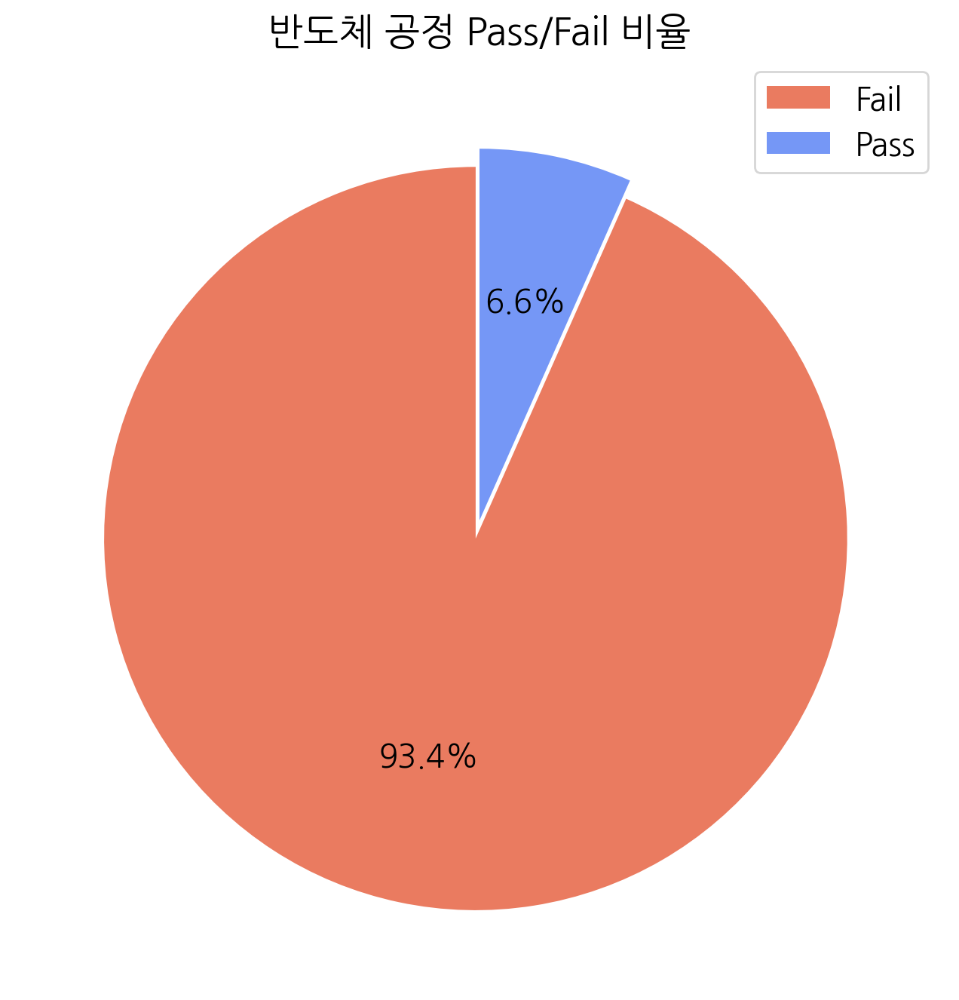

In [ ]:
# 반도체 공정 Pass/Fail 비율 확인
labels, values = np.unique(df['Pass/Fail'], return_counts=True)

explode = [0.05, 0]

color = [colors[-2], colors[1]]

plt.figure(figsize=(8, 8))
plt.title("반도체 공정 Pass/Fail 비율")
plt.pie(values, labels=["", ""], autopct='%.1f%%', startangle=90, explode=explode, shadow=False, colors=color)
plt.legend(["Fail", "Pass"])
plt.show()

In [ ]:
# 2008년 1월 8일 2시 2분 ~ 2008년 12월 10일 18시 47분 데이터
df['Time'].min(), df['Time'].max()

(Timestamp('2008-01-08 02:02:00'), Timestamp('2008-12-10 18:47:00'))

In [ ]:
# 데이터 shape 확인
# 1567개의 row와 592의 column 존재
df.shape

(1567, 592)

In [ ]:
# data type 확인
# datetime(1), float64(590), int64(1), 대부분이 float 형
# null 값이 존재할 때 float64로 표시 되기도 확인 필요
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1567 entries, 0 to 1566
Columns: 592 entries, Time to Pass/Fail
dtypes: datetime64[ns](1), float64(590), int64(1)
memory usage: 7.1 MB


In [ ]:
df[df.notnull()].describe().T

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,...,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,Pass/Fail
count,1561.000000,1560.000000,1553.000000,1553.000000,1553.000000,1553.0,1553.000000,1558.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1564.0,1564.000000,1564.000000,1564.000000,1564.000000,1564.000000,1557.000000,1567.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1566.000000,1566.000000,1566.000000,1566.000000,1566.000000,1566.000000,1566.000000,1566.000000,1543.000000,1543.000000,1566.0,1566.000000,1566.000000,1566.000000,1566.000000,1566.000000,1566.000000,1566.0,1566.000000,1566.000000,1566.0,1563.000000,1563.000000,1563.000000,1563.000000,1563.000000,1563.000000,1560.000000,1561.000000,1561.000000,1561.000000,1560.000000,1560.000000,1560.000000,1561.000000,1561.000000,1561.000000,1561.0,1561.000000,1561.000000,773.000000,773.000000,1561.000000,1543.000000,1543.000000,1543.000000,1543.000000,1543.000000,1543.000000,1543.000000,1543.000000,1566.000000,1555.000000,226.000000,1567.000000,1567.000000,1567.000000,1516.000000,1516.000000,1561.000000,1565.000000,1565.000000,1561.000000,1561.000000,1561.000000,1561.0,1561.000000,1561.00000,1561.000000,1561.000000,1561.000000,1565.000000,1565.000000,1561.000000,1561.000000,1561.000000,1561.000000,549.000000,549.000000,549.000000,852.000000,1567.000000,1567.000000,1567.000000,1567.000000,1567.000000,1543.000000,1567.000000,1567.000000,1558.000000,1558.00000,1558.000000,1558.000000,1558.000000,1558.000000,1558.000000,1558.000000,1558.000000,1558.000000,1558.000000,1559.000000,1559.000000,1559.000000,1562.000000,1561.000000,1560.000000,1553.000000,1553.000000,1553.000000,1553.0,1553.000000,1558.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1564.0,1564.000000,1564.000000,1564.000000,1564.000000,1564.000000,1557.000000,1567.000000,138.000000,138.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1565.000000,1566.000000,1566.000000,1566.000000,1566.000000,1566.000000,1566.000000,1566.000000,1566.000000,1543.0,1566.0

In [ ]:
# null 값 확인 결과 592개의 column 중 538개의 column에서 null 값 존재
cols = df.columns
counts = 0

for col in cols:
    null_counts = df[col].isnull().sum()
    if null_counts > 0:
        counts += 1

print(f"Null이 포함 된 column의 개수는 {counts}")

Null이 포함 된 column의 개수는 538


In [ ]:
# NaN 값 확인 결과 592개의 column 중 538개의 column에서 NaN 값 존재
cols = df.columns
counts = 0

for col in cols:
    nan_counts = df[col].isna().sum()
    if nan_counts > 0:
        counts += 1

print(f"NaN이 포함 된 column의 개수는 {counts}")

NaN이 포함 된 column의 개수는 538


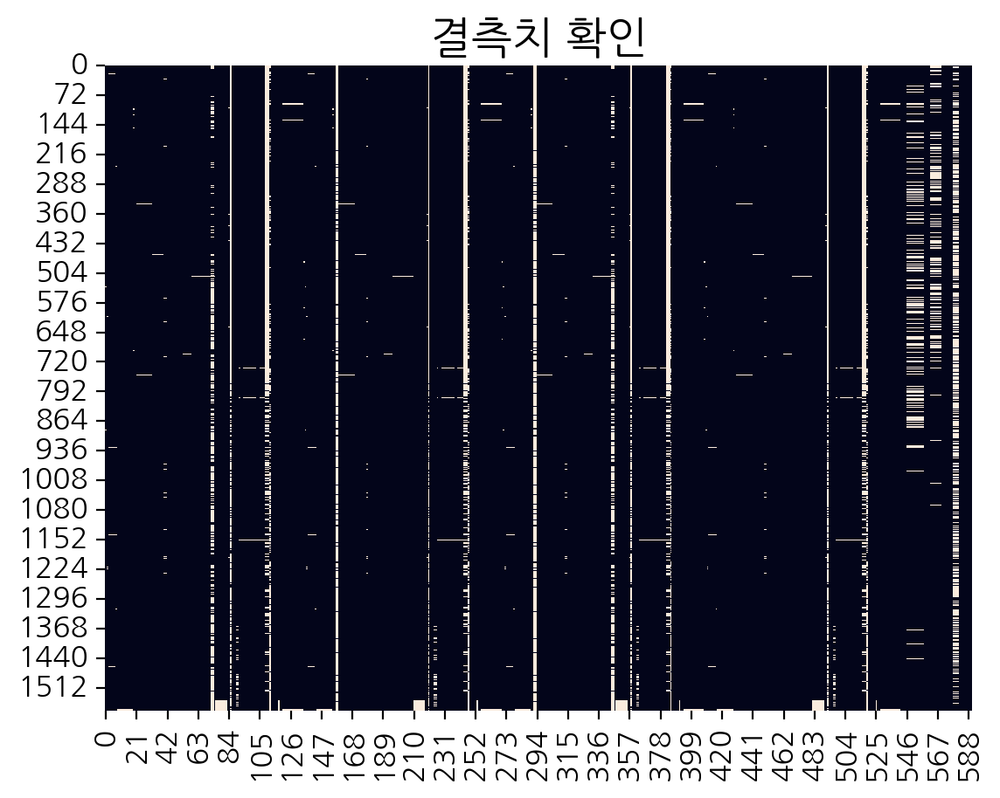

In [ ]:
# 결측치를 그래프로 확인 했을 때, 특정 패턴이 존재하는 것 처럼 보임
plt.title("결측치 확인")
sns.heatmap(df.drop(columns=["Time"]).isnull(), cbar=False)
plt.show()

In [ ]:
# null을 가진 26개의 그룹의 null pattern이 일치 했음.
# 해당 변수들끼리 상관이 있는지 확인 필요
null_counts = df.isnull().sum(axis=0).value_counts().to_frame().index.values
df_isnull_sum = df.drop(columns=['Time', "Pass/Fail"]).isnull().sum().reset_index(name="count")
count = 0

for nc in sorted(null_counts):
    if nc == 0:
        continue
    null_cols = df_isnull_sum[df_isnull_sum['count'] == nc]['index']
    if df[null_cols].isnull().all(axis=1).sum() == nc:
        count += 1

print(f"총 {len(null_counts)}개의 그룹 중 비슷한 null 값의 pattern을 보이는 그룹의 개수는 {count}개 입니다.")

총 23개의 그룹 중 비슷한 null 값의 pattern을 보이는 그룹의 개수는 16개 입니다.


In [ ]:
# null 값 중 데이터의 50% 이상이 결측치인 column 출력
cols = df.columns
counts = 0
null_50 = []

for col in cols:
    null_counts = df[col].isnull().sum()
    if null_counts > 0 :
        percent = (null_counts / len(df)) * 100
        if percent >= 50:
            print(f"{col}의 {null_counts}개의 결측치가 존재하며, 결측치의 비율은 {percent:.2f}%")
            null_50.append(col)

72의 794개의 결측치가 존재하며, 결측치의 비율은 50.67%
73의 794개의 결측치가 존재하며, 결측치의 비율은 50.67%
85의 1341개의 결측치가 존재하며, 결측치의 비율은 85.58%
109의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
110의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
111의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
157의 1429개의 결측치가 존재하며, 결측치의 비율은 91.19%
158의 1429개의 결측치가 존재하며, 결측치의 비율은 91.19%
220의 1341개의 결측치가 존재하며, 결측치의 비율은 85.58%
244의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
245의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
246의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
292의 1429개의 결측치가 존재하며, 결측치의 비율은 91.19%
293의 1429개의 결측치가 존재하며, 결측치의 비율은 91.19%
345의 794개의 결측치가 존재하며, 결측치의 비율은 50.67%
346의 794개의 결측치가 존재하며, 결측치의 비율은 50.67%
358의 1341개의 결측치가 존재하며, 결측치의 비율은 85.58%
382의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
383의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
384의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
492의 1341개의 결측치가 존재하며, 결측치의 비율은 85.58%
516의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
517의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
518의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
578의 949개의 결측치가 존재하며, 결측치의 비율은 60.56%
579의 949개의 결측치가 존재하며, 결측치의 비율은 60

In [ ]:
# NaN 값 중 데이터의 50% 이상이 결측치인 column 출력
cols = df.columns
counts = 0
nan_50 = []

for col in cols:
    nan_counts = df[col].isna().sum()
    if nan_counts > 0:
        percent = (nan_counts / len(df)) * 100
        if percent >= 50:
            print(f"{col}의 {nan_counts}개의 결측치가 존재하며, 결측치의 비율은 {percent:.2f}%")
            nan_50.append(col)

72의 794개의 결측치가 존재하며, 결측치의 비율은 50.67%
73의 794개의 결측치가 존재하며, 결측치의 비율은 50.67%
85의 1341개의 결측치가 존재하며, 결측치의 비율은 85.58%
109의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
110의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
111의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
157의 1429개의 결측치가 존재하며, 결측치의 비율은 91.19%
158의 1429개의 결측치가 존재하며, 결측치의 비율은 91.19%
220의 1341개의 결측치가 존재하며, 결측치의 비율은 85.58%
244의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
245의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
246의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
292의 1429개의 결측치가 존재하며, 결측치의 비율은 91.19%
293의 1429개의 결측치가 존재하며, 결측치의 비율은 91.19%
345의 794개의 결측치가 존재하며, 결측치의 비율은 50.67%
346의 794개의 결측치가 존재하며, 결측치의 비율은 50.67%
358의 1341개의 결측치가 존재하며, 결측치의 비율은 85.58%
382의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
383의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
384의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
492의 1341개의 결측치가 존재하며, 결측치의 비율은 85.58%
516의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
517의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
518의 1018개의 결측치가 존재하며, 결측치의 비율은 64.96%
578의 949개의 결측치가 존재하며, 결측치의 비율은 60.56%
579의 949개의 결측치가 존재하며, 결측치의 비율은 60

In [ ]:
# 데이터의 50% 이상이 결측치인 columns의 개수는 28개, null값과 nan값의 column이 동일함
set(nan_50) - set(null_50), len(nan_50), len(null_50)

(set(), 28, 28)

In [ ]:
# Pass/Fail에 따른 결측치 50%를 넘는 feature들의 데이터 개수
df[nan_50 + ["Pass/Fail"]].groupby("Pass/Fail").count()

,72,73,85,109,110,111,157,158,220,244,245,246,292,293,345,346,358,382,383,384,492,516,517,518,578,579,580,581
Pass/Fail,,,,,,,,,,,,,,,,,,,,,,,,,,,,
-1,705,705,215,519,519,519,130,130,215,519,519,519,130,130,705,705,215,519,519,519,215,519,519,519,573,573,573,573
1,68,68,11,30,30,30,8,8,11,30,30,30,8,8,68,68,11,30,30,30,11,30,30,30,45,45,45,45


In [ ]:
# 결측치가 50%가 넘는 값에도 총 Pass 개수 대비 Pass의 수가 50이 넘는 값들이 존재
# 향후 EDA를 통해 변수 제거 여부 고민해봐야 할 듯
df_pf = df[nan_50 + ["Pass/Fail"]].groupby("Pass/Fail").count()
df_pf.loc[-1, :] = (df_pf.loc[-1, :].values / len(df[df['Pass/Fail'] == -1])) * 100
df_pf.loc[1, :] = (df_pf.loc[1, :].values / len(df[df['Pass/Fail'] == 1])) * 100
df_pf

,72,73,85,109,110,111,157,158,220,244,245,246,292,293,345,346,358,382,383,384,492,516,517,518,578,579,580,581
Pass/Fail,,,,,,,,,,,,,,,,,,,,,,,,,,,,
-1,48.188653,48.188653,14.695830,35.475051,35.475051,35.475051,8.885851,8.885851,14.695830,35.475051,35.475051,35.475051,8.885851,8.885851,48.188653,48.188653,14.695830,35.475051,35.475051,35.475051,14.695830,35.475051,35.475051,35.475051,39.166097,39.166097,39.166097,39.166097
1,65.384615,65.384615,10.576923,28.846154,28.846154,28.846154,7.692308,7.692308,10.576923,28.846154,28.846154,28.846154,7.692308,7.692308,65.384615,65.384615,10.576923,28.846154,28.846154,28.846154,10.576923,28.846154,28.846154,28.846154,43.269231,43.269231,43.269231,43.269231


In [ ]:
# 상수값 확인
counts = 0

for col in cols:
    num_values = len(df[col].unique())
    if num_values == 1:
        counts += 1


print(f"단일 값만 포함된 column의 개수는 {counts}")

단일 값만 포함된 column의 개수는 0


In [ ]:
# Null값과 NaN값 제거 후 상수 값 확인
counts = 0
constant_cols = []

for col in cols:
    num_values = len(df[col].dropna().unique())
    if num_values == 1:
        constant_cols.append(col)
        counts += 1

print(f"단일 값만 포함 된 column의 개수는 {counts}")

단일 값만 포함 된 column의 개수는 116


In [ ]:
# 값이 상수 값만 존재하더라도 그 비율이 적으면 데이터 손실로 인해 값이 하나만 존재할 수도 있음
# 이를 확인 하고자 결측치를 제외했을때, 전체 데이터 중 상수 값이 차지하는 비율을 확인함.
# 상수 값만 포함한 feature들 모두 95% 이상 단일 값만 갖고 있음
# 이후, feature들을 제거하고 데이터 분석을 진행할 필요가 있음

describe_frame = df[constant_cols].describe().T
describe_frame['constant_per'] = describe_frame['count'] / len(df) * 100
len(describe_frame), len(describe_frame[describe_frame['constant_per'].apply(lambda x : True if x >= 95 else False)])

(116, 116)

In [ ]:
# IQR을 이용한 이상치 탐지
# 이상치가 존재하는 columns은 453개
def get_outliers_by_iqr(df):
    outlier_cols = []

    for col in df.columns:
        if col == 'Pass/Fail':
            continue

        q1 = df[col].quantile(0.25)
        q3 = df[col].quantile(0.75)
        iqr = q3 - q1

        lower_bound = q1 - 1.5 * iqr
        upper_bound = q3 + 1.5 * iqr

        if df[col][(df[col] < lower_bound) | (df[col] > upper_bound)].any():
            outlier_cols.append(col)

    return outlier_cols

outlier_cols = get_outliers_by_iqr(df)
print(len(outlier_cols))

453


In [ ]:
# 이상치가 존재하지 않는 column 확인
no_outlier_cols = sorted(list(set(df.columns) - set(outlier_cols)))

In [ ]:
# 이상치가 존재하지 않지만, min값과 25%의 값이 0으로 이루어진 feature가 존재
df[no_outlier_cols].drop(columns=constant_cols + ["Pass/Fail"]).describe().T

,count,mean,std,min,25%,50%,75%,max
132,1559.0,2.318545,0.053181,2.1911,2.277300,2.31240,2.35830,2.4723
136,1561.0,138.194747,53.909792,36.1000,90.000000,134.60000,181.00000,295.8000
267,1559.0,0.070587,0.029649,0.0198,0.044000,0.07060,0.09165,0.1578
268,1559.0,19.504677,7.344404,6.0980,13.828000,17.97700,24.65300,40.8550
304,1565.0,0.132076,0.064867,0.0138,0.072800,0.13720,0.17850,0.3337
405,1559.0,0.024208,0.010728,0.0062,0.014000,0.02390,0.03230,0.0514
409,1561.0,4.580430,1.776843,1.2163,3.012800,4.48970,5.93670,9.5765
418,1565.0,320.259235,287.704482,0.0000,0.000000,302.17760,524.00220,999.3160
419,1565.0,309.061299,325.448391,0.0000,0.000000,272.44870,582.93520,998.6813
441,1566.0,0.802081,0.184213,0.3512,0.679600,0.80760,0.92760,1.2771


In [ ]:
# 이상치가 존재하지 않는 column에서 0의 비율 추출하기
# 특정 colum은 50%가 넘는 값이 0으로만 이루어져 있음
df[no_outlier_cols].drop(columns=constant_cols + ["Pass/Fail"]).eq(0).sum() / len(df) * 100

132     0.000000
136     0.000000
267     0.000000
268     0.000000
304     0.000000
405     0.000000
409     0.000000
418    32.673899
419    45.437141
441     0.000000
47      0.000000
482    30.759413
486    32.163369
488    14.613912
499    54.371410
500    58.008934
51      0.000000
511    52.329292
539     0.000000
542     0.000000
548     0.000000
85      0.000000
dtype: float64

In [ ]:
# 50%가 넘는 값이 0인 colum 추출
df_per_zero = df[no_outlier_cols].drop(columns=constant_cols + ["Pass/Fail"]).eq(0).sum() / len(df) * 100
zero_columns = df_per_zero[df_per_zero >= 50].index.to_list()

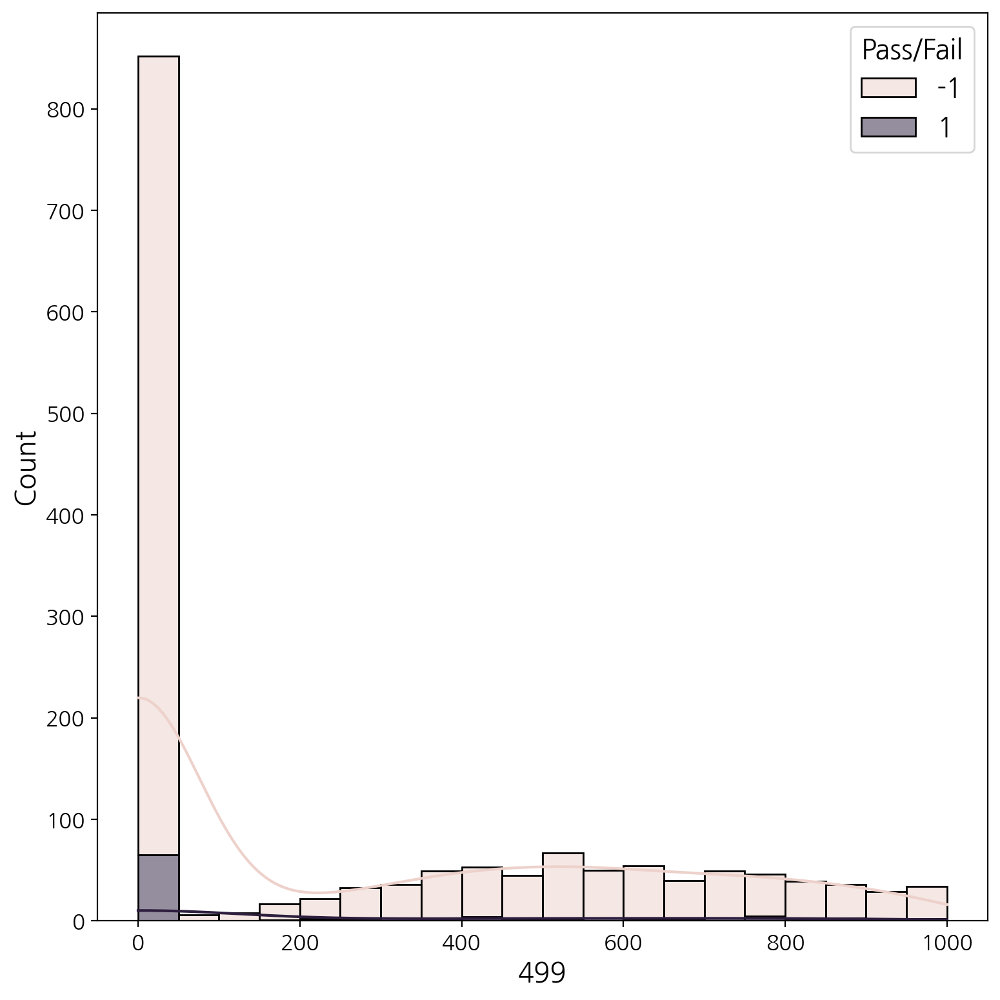

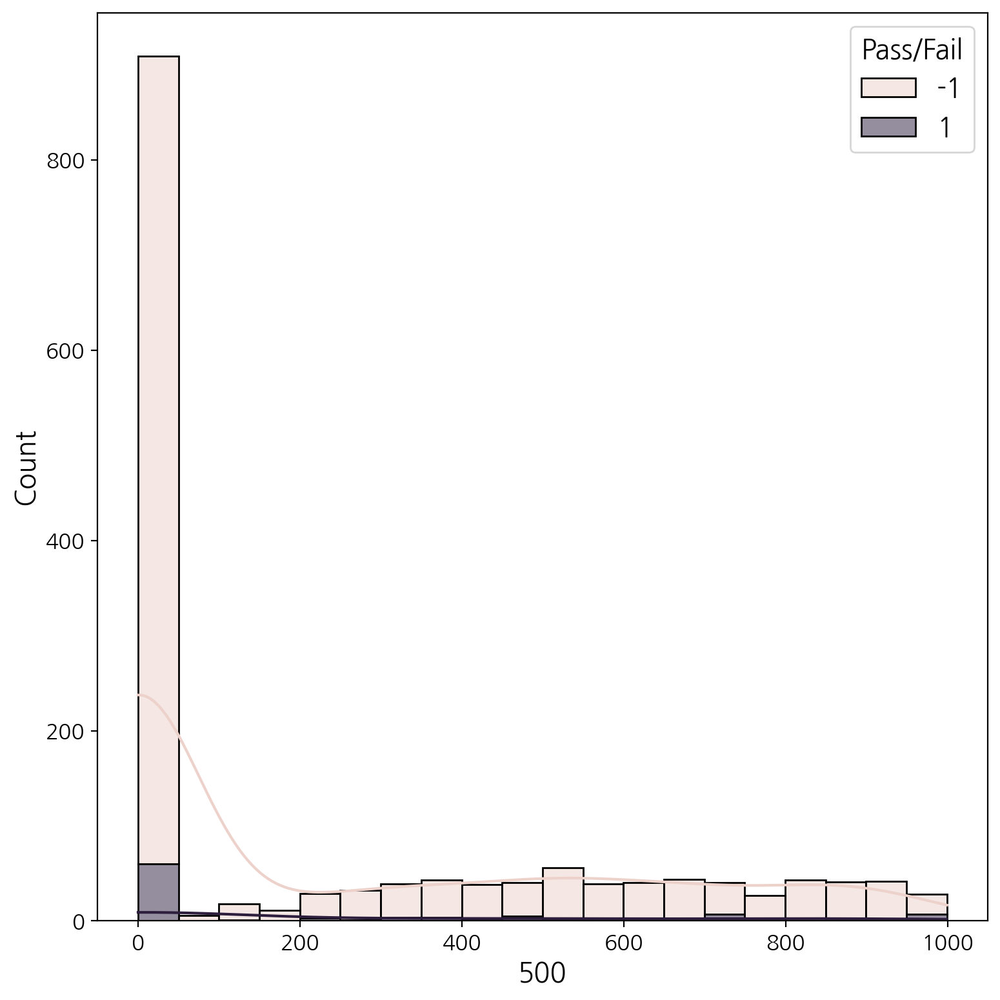

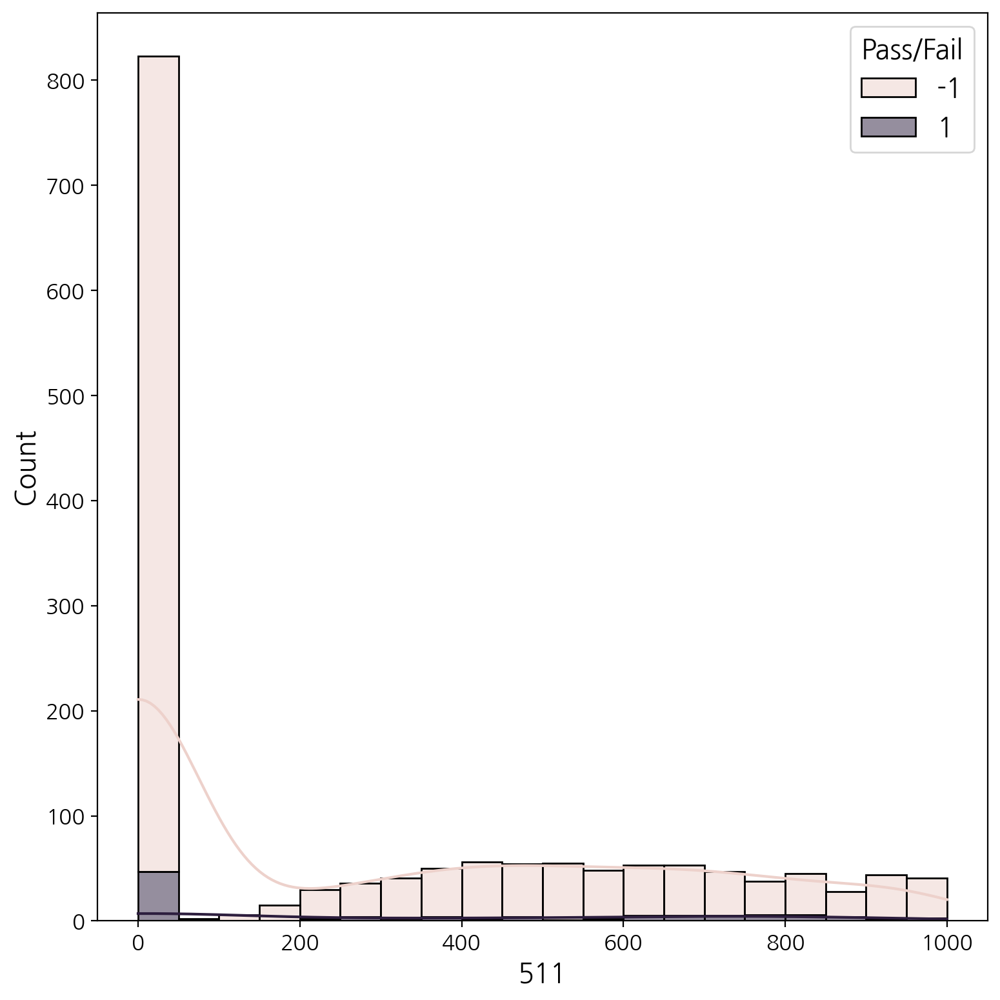

In [ ]:
# Pass의 값에도 0이 포함된 경우가 존재
for zc in zero_columns:
    plt.figure(figsize=(8, 8))
    sns.histplot(data=df, x=zc, kde=True, bins=20, hue="Pass/Fail", multiple="stack")

    plt.tight_layout()
    plt.show()

In [ ]:
# 데이터의 표준편차가 0.005이하인 값들의 column
df_desc = df.drop(columns=["Time", "Pass/Fail"] + constant_cols).describe().T
std_close_zero = df_desc[df_desc['std'] <= 0.005].index.to_list()

print(f"std가 0.005 이하인 colum의 개수는 {len(std_close_zero)}개 입니다.")

std가 0.005 이하인 colum의 개수는 38개 입니다.


In [ ]:
# 중복값이 존재하는지 확인
# 중복값 존재하지 않음
len(df[df.duplicated()]), len(df)

(0, 1567)

In [ ]:
# datetime이 동일한 값들이 존재
df['Time'].value_counts()

2008-10-15 01:52:00    3
2008-07-27 22:28:00    2
2008-03-10 19:23:00    2
2008-08-19 05:11:00    2
2008-09-18 03:58:00    2
                      ..
2008-08-10 07:10:00    1
2008-08-10 06:25:00    1
2008-08-10 05:38:00    1
2008-08-10 05:35:00    1
2008-12-10 18:47:00    1
Name: Time, Length: 1534, dtype: int64

In [ ]:
# 같은 시간이라도 Pass/Fail에서 차이가 나는 때가 존재
# 세 가지 시간대에서 서로 다른 Pass/Fail 결과가 나타남
date_times = df[df['Time'].duplicated()]['Time'].unique()
for date_time in date_times:
    pf_values = df[df['Time'] == date_time]["Pass/Fail"].values
    bool_values = pf_values == 1
    if not ((sum(bool_values) == 0) or (sum(bool_values) == len(pf_values))):
        print(date_time)

2008-05-08T07:12:00.000000000
2008-08-31T10:59:00.000000000
2008-05-10T00:33:00.000000000


## **🌞 Data Analysis 2단계**  
**┗ 데이터 EDA 및 분석 프로세스 설계**  
---

```
데이터 탐색을 통해 데이터에 대한 이해도를 향상시키고, 분석 방향성을 설계하는 단계

※ 수강생 학습 및 적용해야하는 사항
 - 데이터 표준화(standardization), 정규화(normalization) 개념
 - 왜 표준화/정규화를 해야하는지?
 - Feature Engineering의 이해
```  

### · Data Readiness Check
---
* 데이터 특성 파악을 위한 초기 탐색
* 현재 우리가 가지고 있는 데이터로 문제를 풀 수 있는지 확인하는 과정

In [ ]:
# Pass/Fail의 변수명을 Target 변경
df["Target"] = df["Pass/Fail"]
df.drop(columns=["Pass/Fail"], axis=1, inplace=True)

In [ ]:
df = df.sort_values("Time").reset_index().drop(columns='index')

In [ ]:
df['month'] = df['Time'].dt.month
df['day'] = df['Time'].dt.day
df['hour'] = df['Time'].dt.hour
df['minute'] = df['Time'].dt.minute

#### Time column 확인

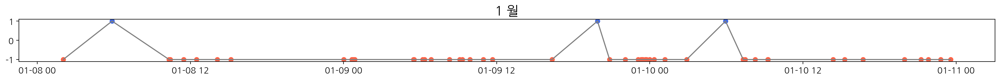

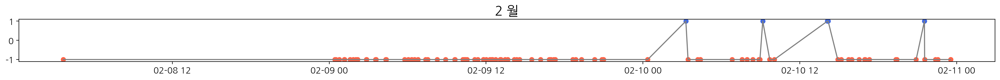

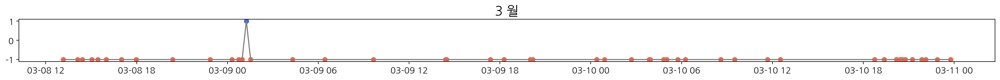

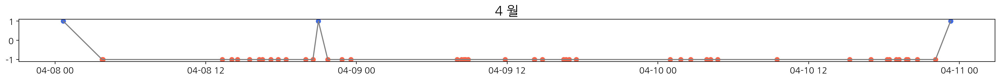

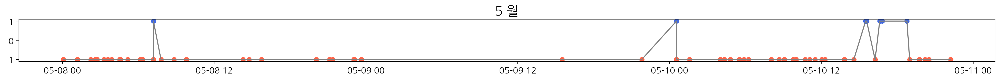

...

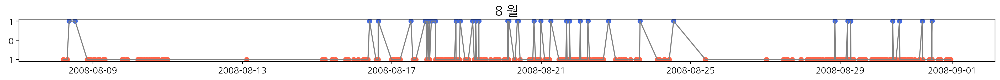

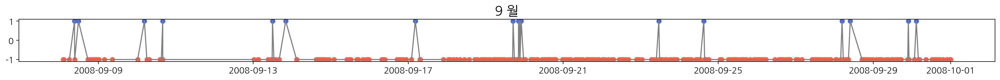

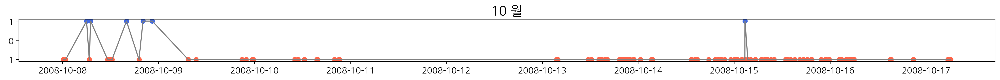

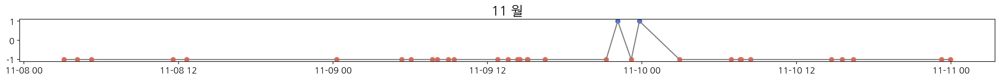

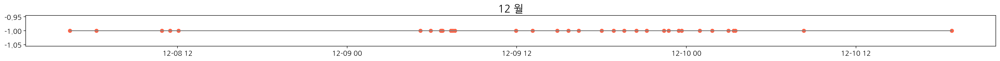

In [ ]:
# 날짜별로 언제 공정에 문제가 생겼는지 확인해보기
# 여름에 Pass의 횟수가 많은 경향이 있다.
for idx in range(12):
    plt.figure(figsize=(24, 15))
    plt.subplot(12, 1, idx+1)
    data = df[df['month'] == (idx + 1)]

    plt.plot(data['Time'], data["Target"], color='grey')
    plt.scatter(data[data['Target'] == 1]['Time'], data[data['Target'] == 1]["Target"], marker='o', color='royalblue')
    plt.scatter(data[data['Target'] == -1]['Time'], data[data['Target'] == -1]["Target"], marker='o', color='tomato')
    plt.title(f"{idx+1} 월")

plt.tight_layout()
plt.show()

In [ ]:
# 여름에 공정 데이터가 많아서 더 많은 Pass가 나올 수 있지 않을까 하여 월 별로 count를 세보아야 할 것 같다.
# 다른 달에 비해 8월, 9월의 공정의 데이터 수가 많아 Pass가 많은 것 처럼 보였음.
# 12월에는 Pass가 존재하지 않음
df.groupby(['Target', "month"])['month'].count().to_frame().unstack()

month                                                                 \
month     1     2     3     4     5     6     7      8      9      10    11   
Target                                                                        
-1      48.0  93.0  49.0  46.0  55.0  61.0  98.0  433.0  396.0  117.0  33.0   
 1       3.0   5.0   1.0   3.0   7.0   6.0  16.0   38.0   17.0    6.0   2.0   

              
month     12  
Target        
-1      34.0  
 1       NaN

In [ ]:
# 월 별 Pass/Fail의 비율로 따졌을 땐, 5월과 7월에서 가장 많은 것을 확인 할 수 있었음.
monthly_total = df.groupby('month')['month'].count()
monthly_percentage = df.groupby(['Target', 'month'])['month'].count().unstack() / monthly_total * 100
monthly_percentage

month,1,2,3,4,5,6,7,8,9,10,11,12
Target,,,,,,,,,,,,
-1,94.117647,94.897959,98.0,93.877551,88.709677,91.044776,85.964912,91.932059,95.883777,95.121951,94.285714,100.0
1,5.882353,5.102041,2.0,6.122449,11.290323,8.955224,14.035088,8.067941,4.116223,4.878049,5.714286,NaN


In [ ]:
# 오전과 오후 시간 중 언제 Pass/Fail이 많을까?
df['isAm'] = (df['hour'] < 12).astype(int)

In [ ]:
df.groupby(["Target", "isAm"])['isAm'].count().unstack()

isAm,0,1
Target,,
-1,759,704
1,57,47


In [ ]:
# 오전과 오후 간 Pass/Fail의 차이가 존재하는지 Chi-Square 검정을 실시하면
# 두 변수는 독립적일 가능성이 높다.
from scipy.stats import chi2_contingency

# 데이터 준비
observed_counts = df.groupby(["Target", "isAm"])['isAm'].count().unstack().values

# 카이제곱 검정 수행
chi2, p, dof, expected_counts = chi2_contingency(observed_counts)

# 결과 출력
print("카이제곱 통계량:", chi2)
print("p-value:", p)
print("자유도:", dof)
print("기대 빈도:", expected_counts)

# 유의도 판단
if p < 0.05:
    print("두 변수는 독립하지 않습니다.")
else:
    print("두 변수는 독립할 가능성이 높습니다.")

카이제곱 통계량: 0.22654177573150208
p-value: 0.6340999907026341
자유도: 1
기대 빈도: [[761.84301213 701.15698787]
 [ 54.15698787  49.84301213]]
두 변수는 독립할 가능성이 높습니다.


In [ ]:
# 계절로 나눠보기
df["season"] = ""
df.loc[df['month'].isin([3, 4, 5]), 'season'] = "봄"
df.loc[df['month'].isin([6, 7, 8]), 'season'] = "여름"
df.loc[df['month'].isin([9, 10, 11]), 'season'] = "가을"
df.loc[df['month'].isin([12, 1, 2]), 'season'] = "겨울"

In [ ]:
df.groupby(["Target", "season"])['season'].count().unstack()

season,가을,겨울,봄,여름
Target,,,,
-1,546,175,150,592
1,25,8,11,60


In [ ]:
# 계절 변수가 Target에 영향을 미칠 수 있음.
# 하지만, 공정의 경우 계절의 영향을 받을지는 의문
# 데이터 준비
observed_counts = df.groupby(["Target", "season"])['season'].count().unstack().values

# 카이제곱 검정 수행
chi2, p, dof, expected_counts = chi2_contingency(observed_counts)

# 결과 출력
print("카이제곱 통계량:", chi2)
print("p-value:", p)
print("자유도:", dof)
print("기대 빈도:", expected_counts)

# 유의도 판단
if p < 0.05:
    print("Target 변수와 Season 변수는 독립이지 않습니다.")
else:
    print("Target 변수와 Season 변수는 독립일 가능성이 높습니다.")

카이제곱 통계량: 13.152173289315567
p-value: 0.00431881606469653
자유도: 3
기대 빈도: [[533.10338226 170.85449904 150.31461391 608.72750479]
 [ 37.89661774  12.14550096  10.68538609  43.27249521]]
Target 변수와 Season 변수는 독립이지 않습니다.


#### Null 값 pattern이 비슷한 group 비교

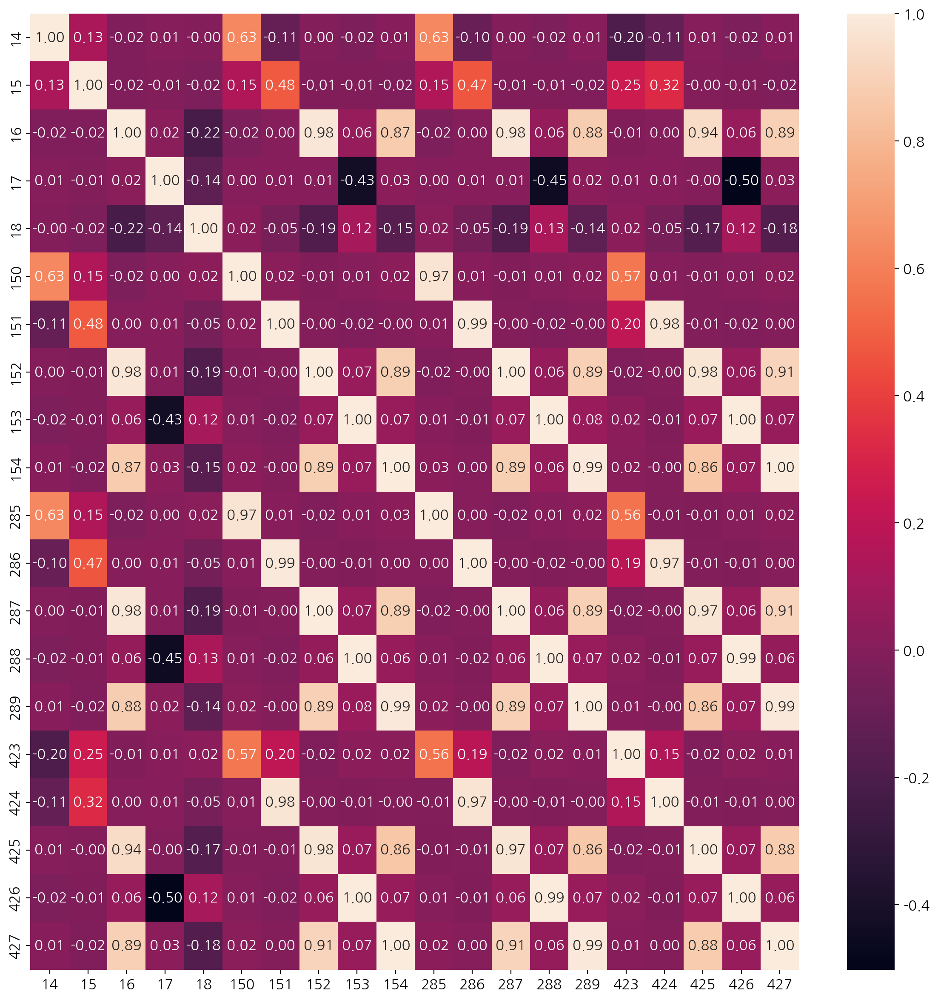

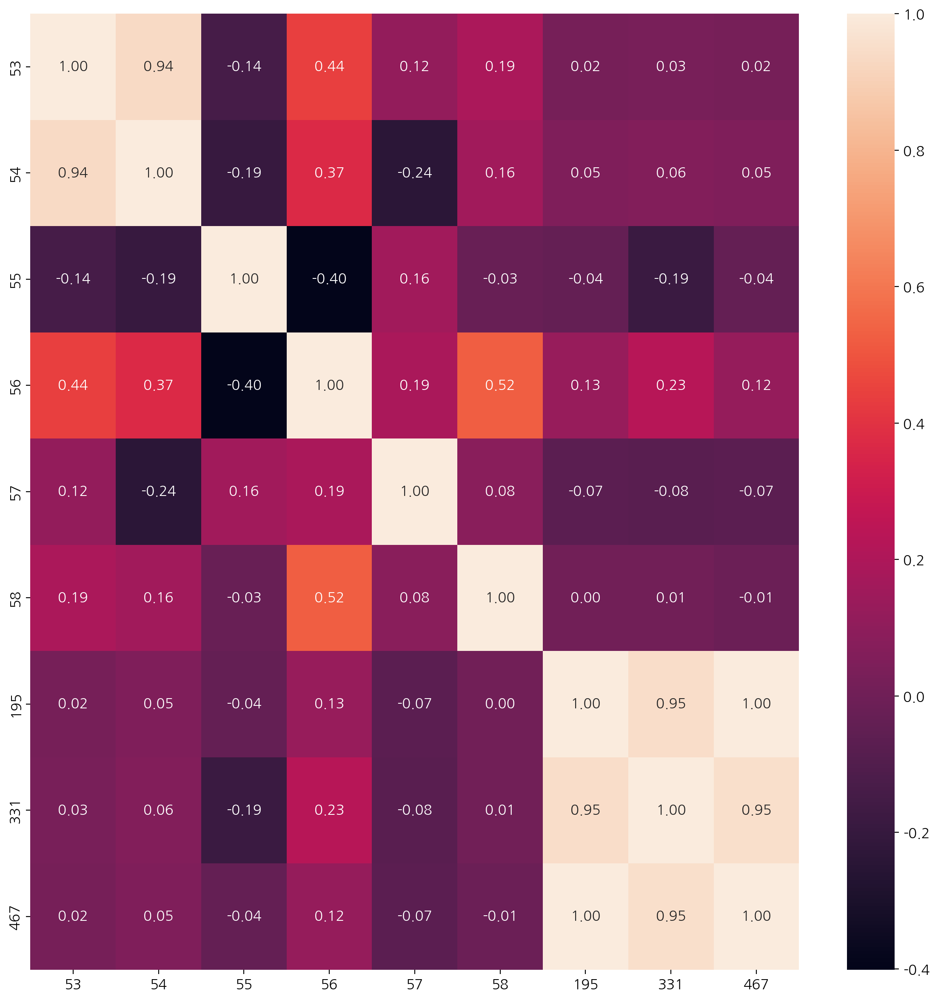

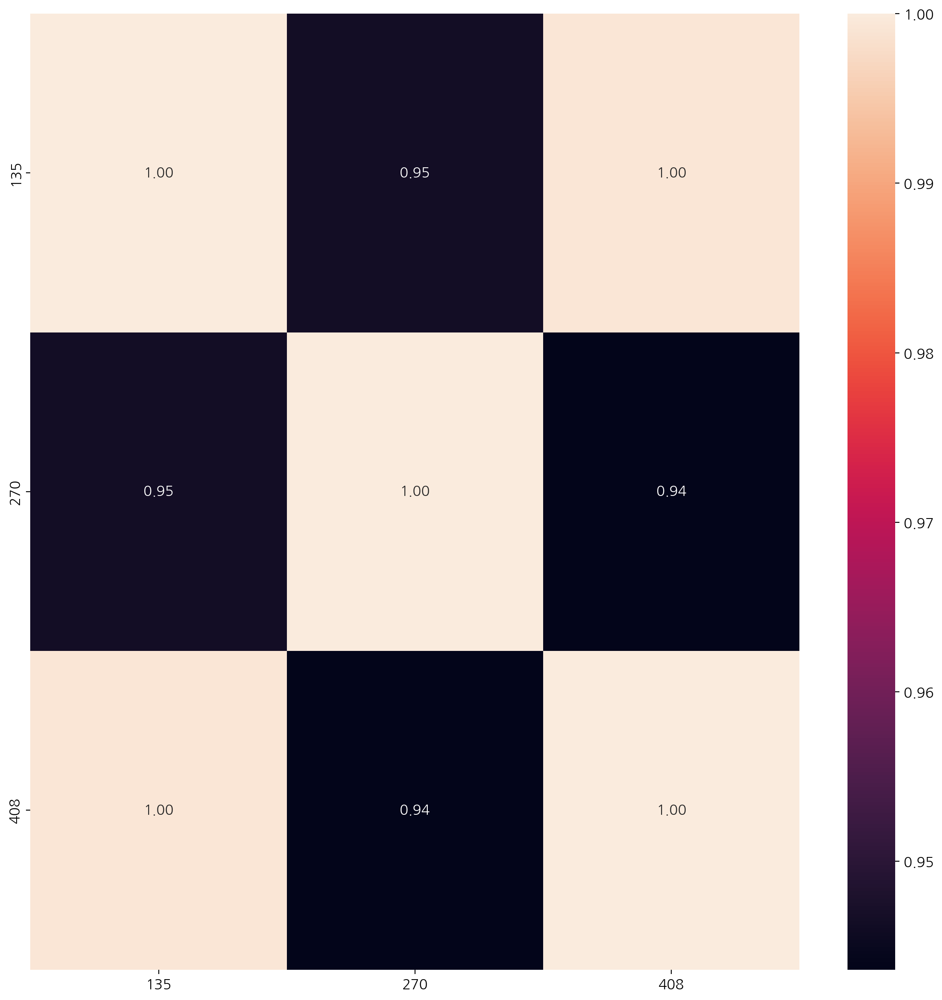

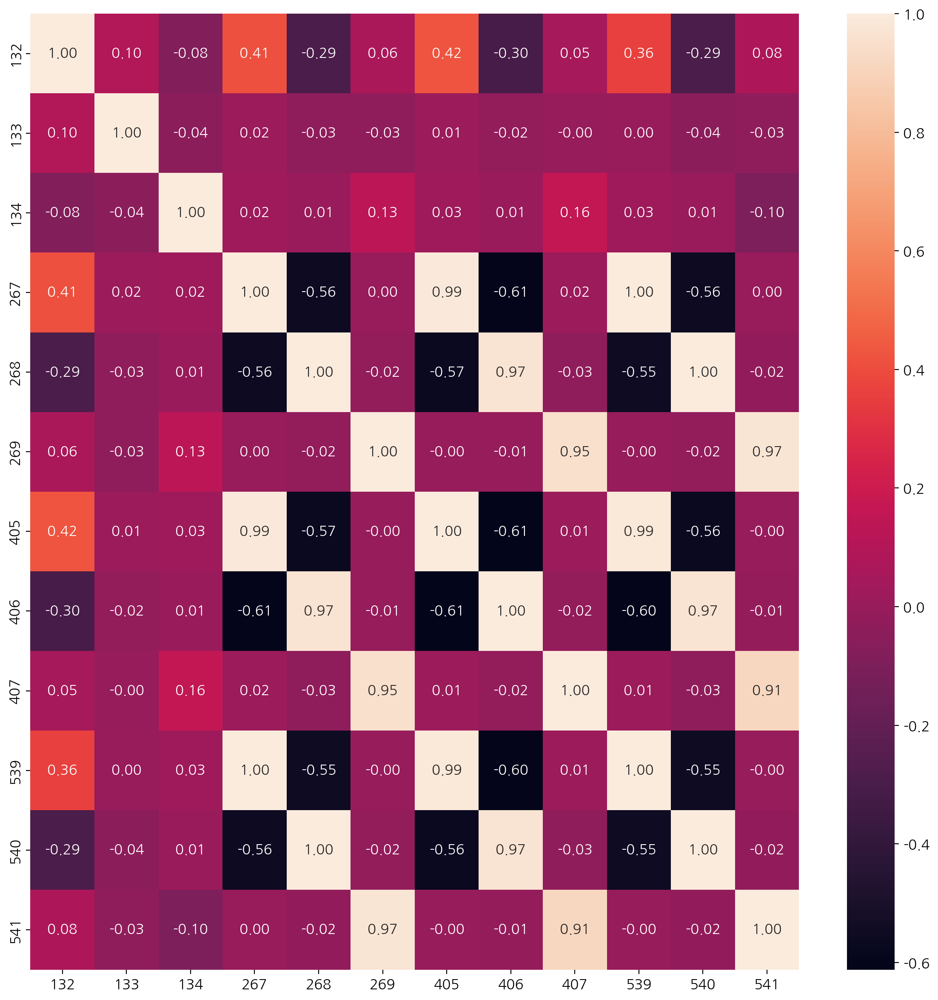

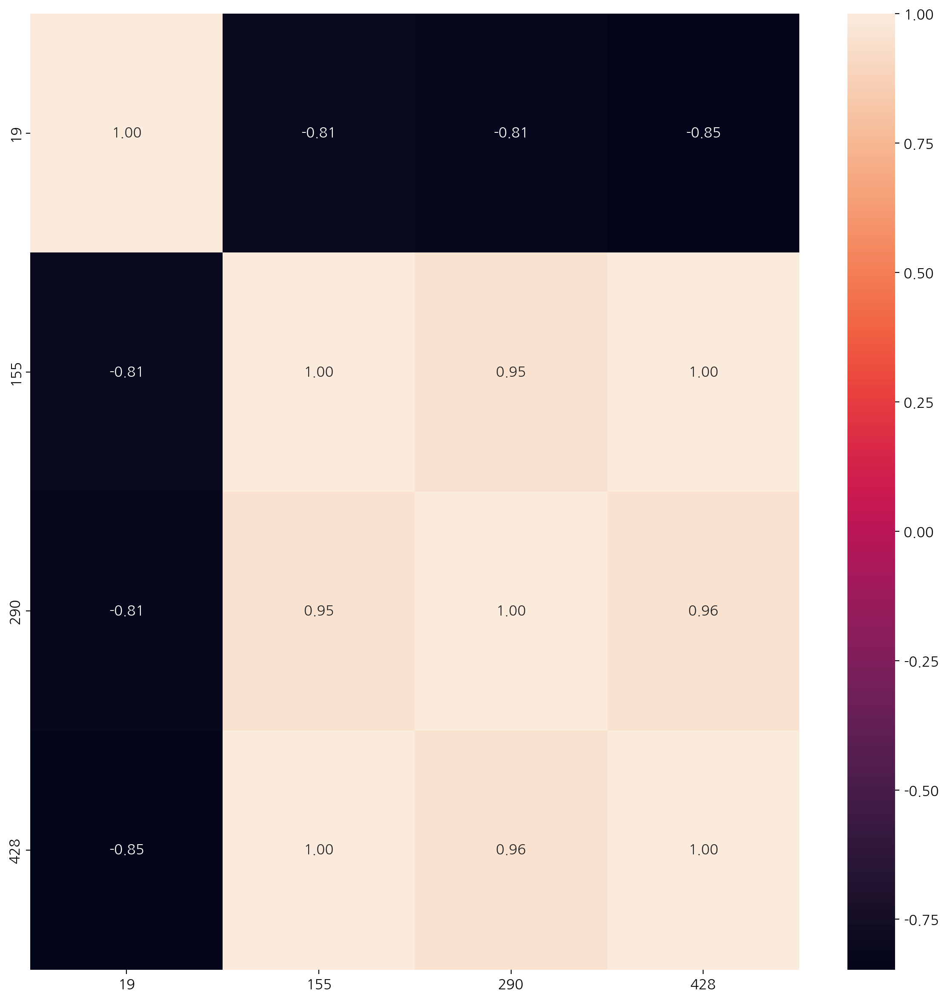

...

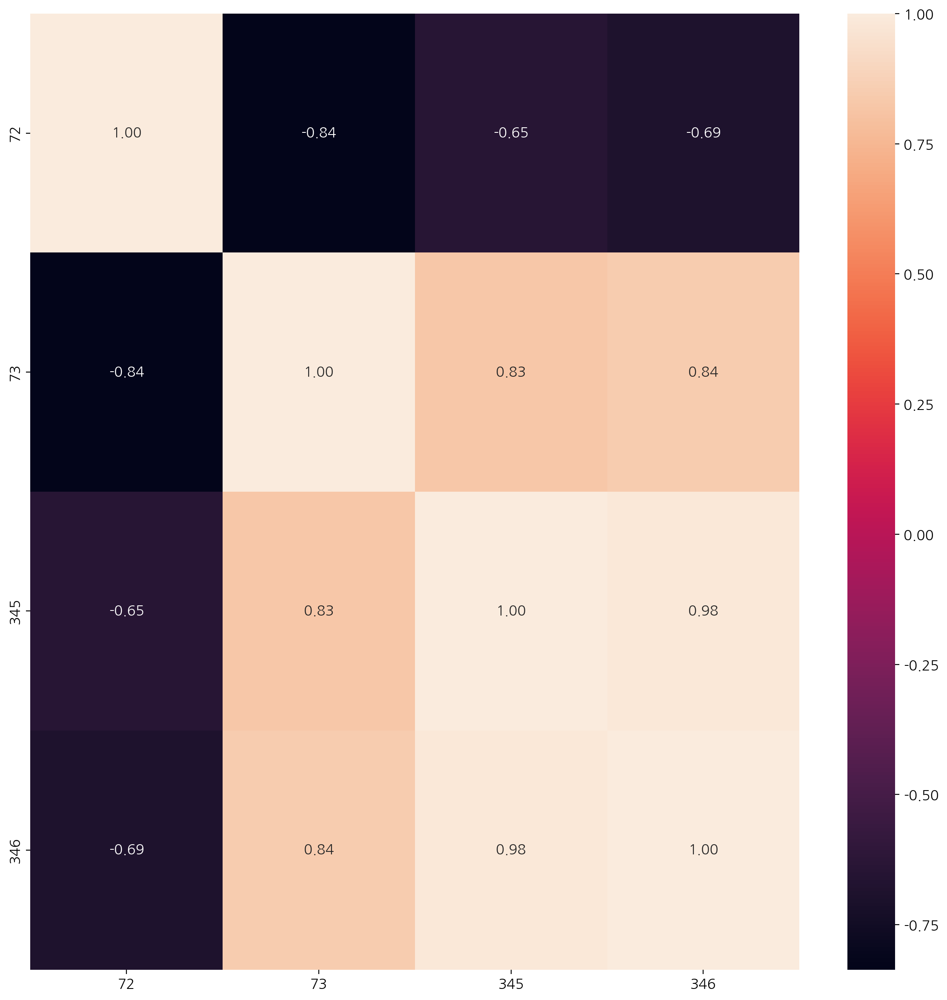

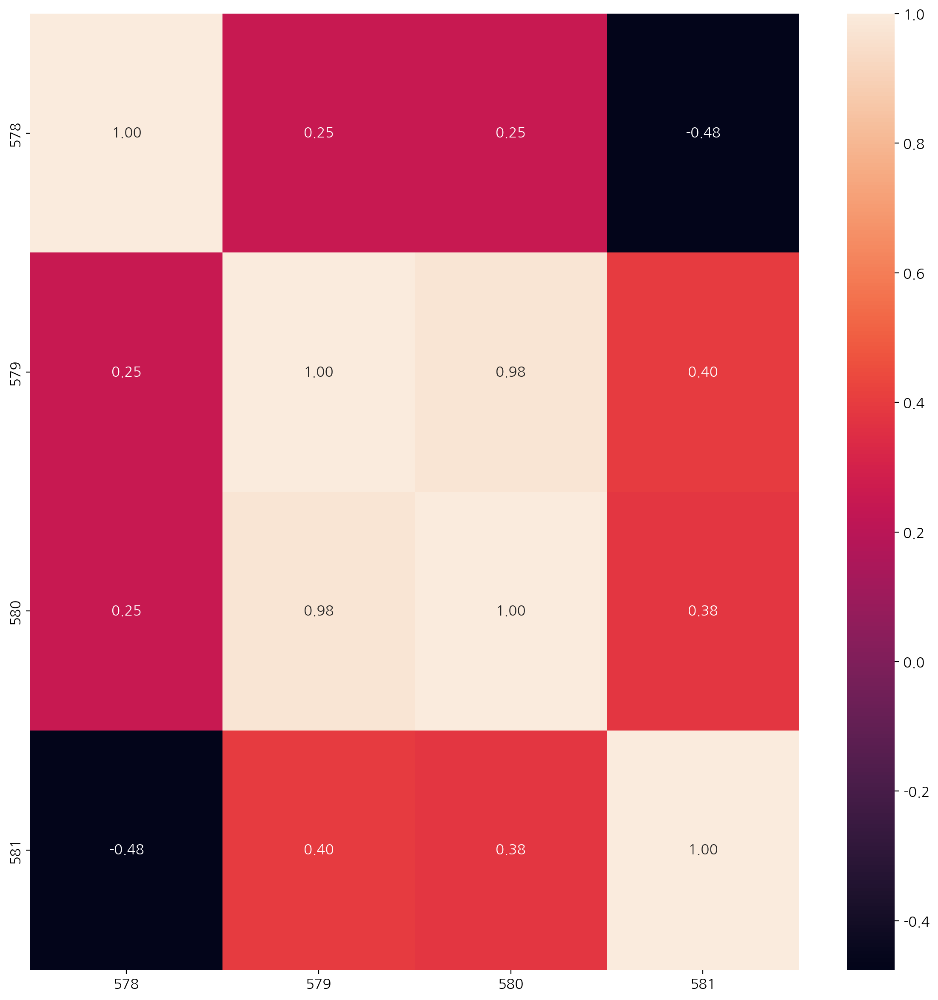

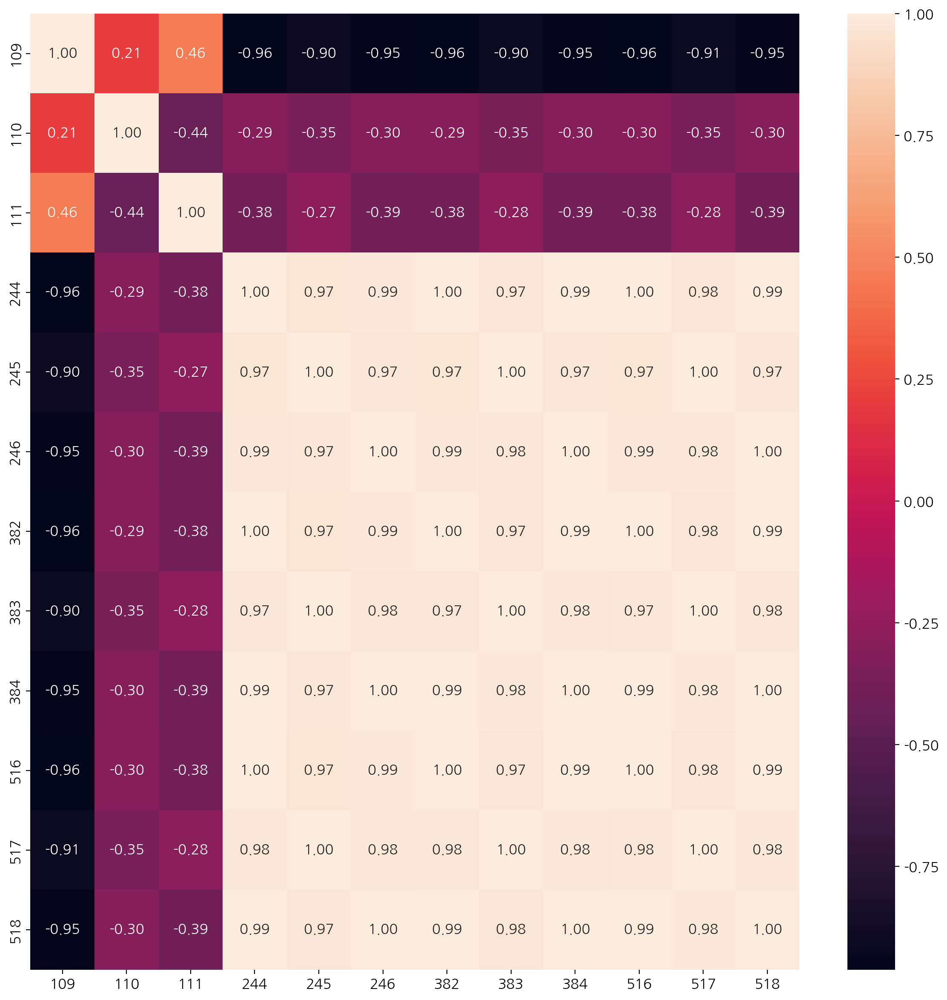

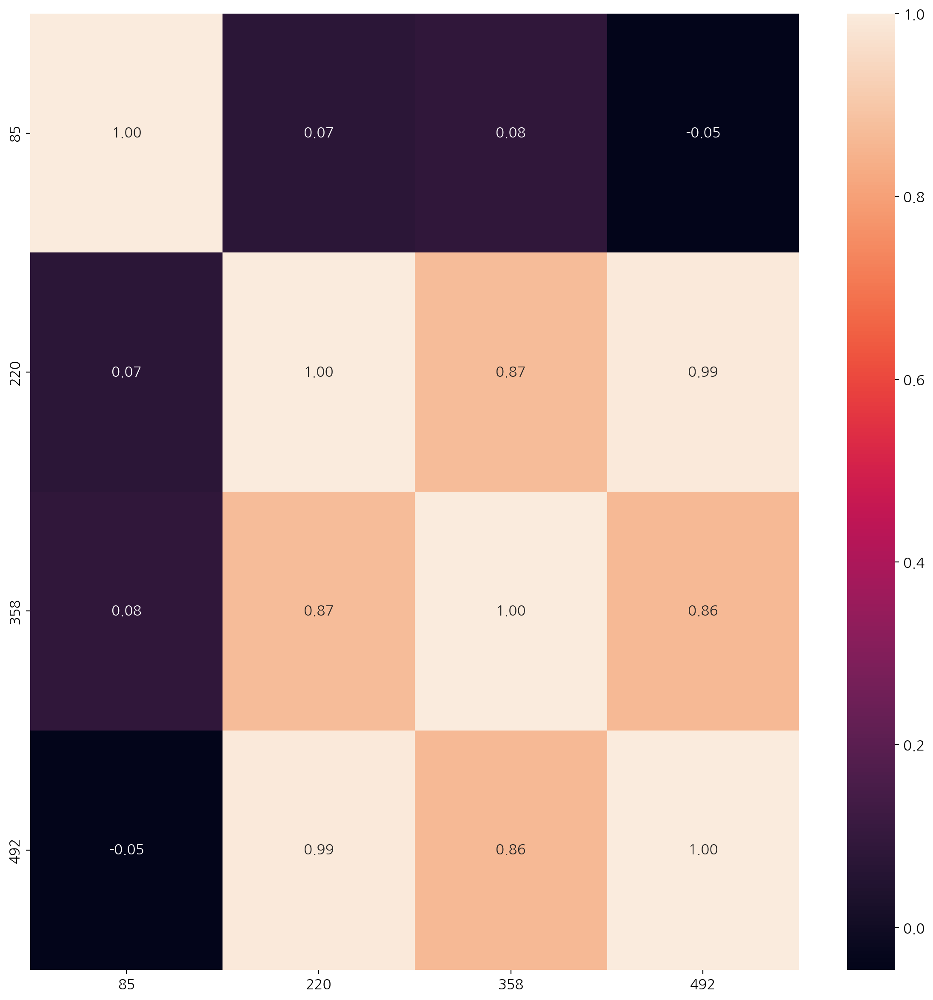

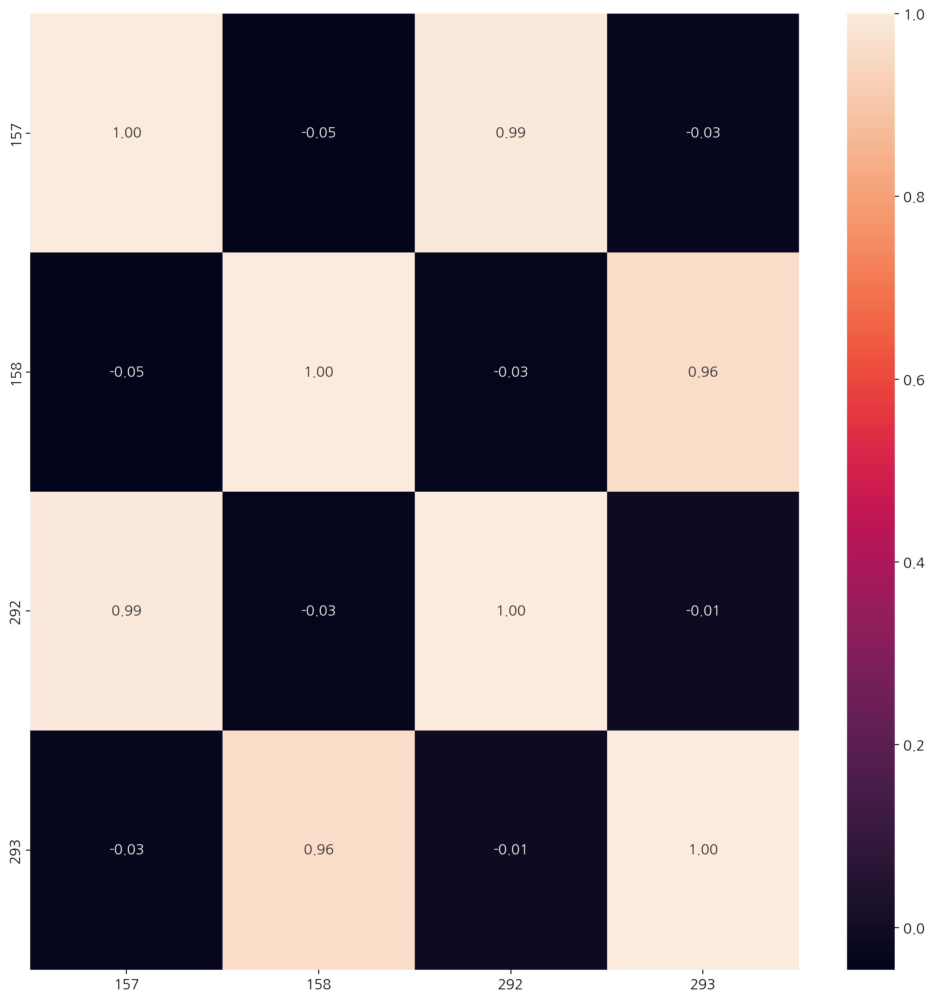

In [ ]:
# null의 pattern이 비슷한 변수들 중, 다중 공선성을 보이는 변수들이 존재
null_counts = df.isnull().sum(axis=0).value_counts().to_frame().index.values
df_isnull_sum = df.drop(columns=['Time', "Target"] + constant_cols).isnull().sum().reset_index(name="count")
count = 0

for nc in sorted(null_counts):
    if nc == 0:
        continue
    null_cols = df_isnull_sum[df_isnull_sum['count'] == nc]['index'].to_list()

    if df[null_cols].isnull().all(axis=1).sum() == nc:
        plt.figure(figsize=(12, 12))
        sns.heatmap(df[null_cols].corr(), annot=True, fmt='.2f', annot_kws={"fontsize": 12})
        plt.tight_layout()
        plt.show()

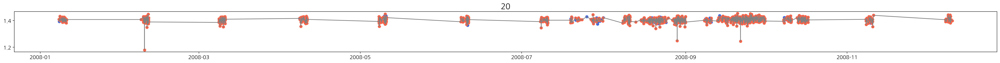

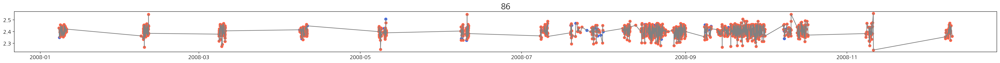

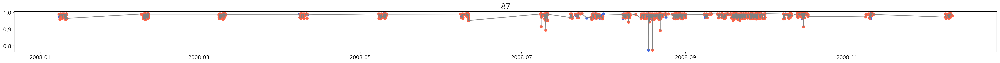

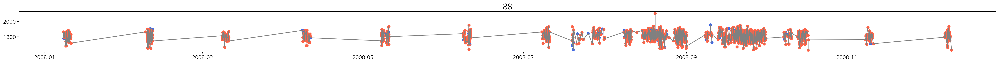

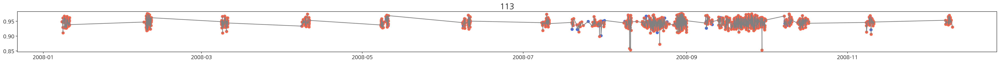

...

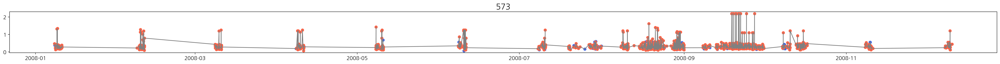

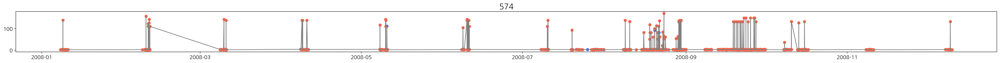

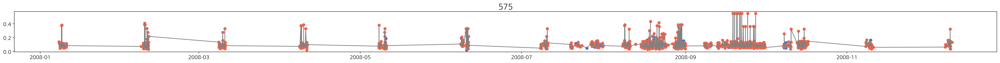

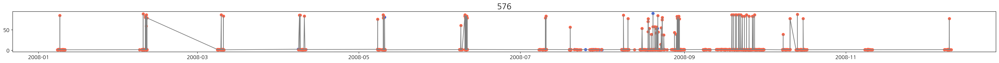

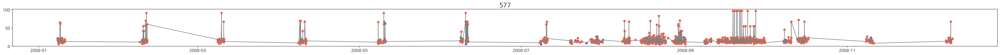

In [ ]:
# 특정 column에서 일부 튀는 값들이 존재
# 이상치가 존재하지만, column들의 의미를 확실히 알 수 없음.
# 데이터의 전반적인 경향성에서 벗어나는 값들만 제거가 필요
not_null_columns = df.loc[:, df.notnull().all().values].iloc[:, :-7].drop(columns="Time").columns

for idx, nc in enumerate(not_null_columns):
    plt.figure(figsize=(40, 2*len(not_null_columns)))
    plt.subplot(len(not_null_columns), 1, idx+1)
    data = df[[nc] + ["Time", "Target"]]

    plt.plot(data['Time'], data[nc], color='grey')
    plt.scatter(data[data['Target'] == 1]['Time'], data[data['Target'] == 1][nc], marker='o', color='royalblue')
    plt.scatter(data[data['Target'] == -1]['Time'], data[data['Target'] == -1][nc], marker='o', color='tomato')
    plt.title(f"{nc}")

plt.tight_layout()
plt.show()

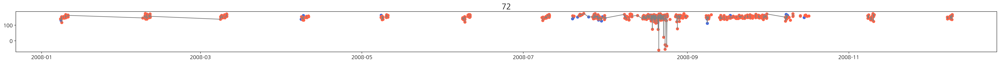

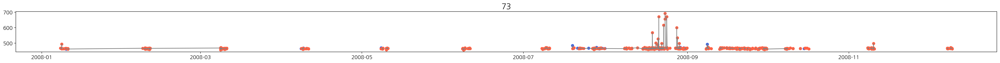

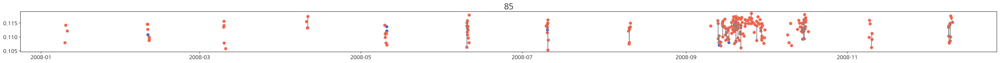

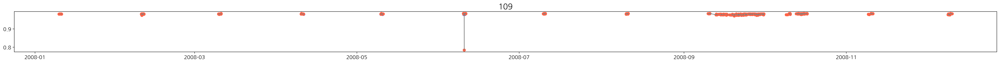

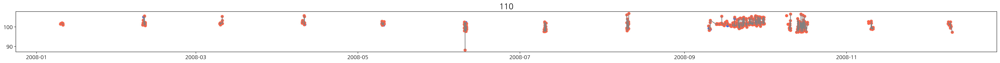

...

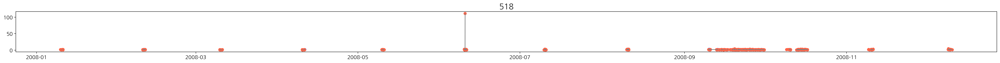

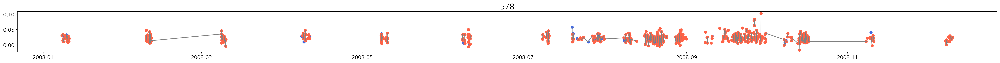

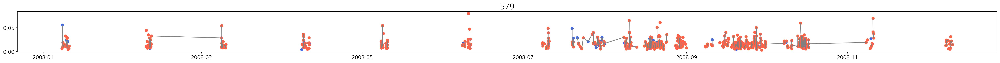

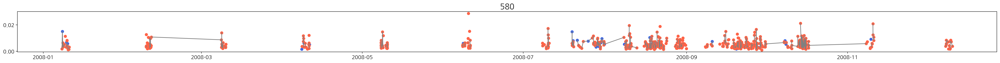

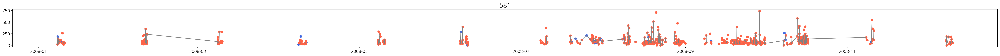

In [ ]:
# 변수 자체에서 별다른 패턴을 보이진 않음
for idx, nc in enumerate(null_50):
    plt.figure(figsize=(40, 2*len(not_null_columns)))
    plt.subplot(len(not_null_columns), 1, idx+1)
    data = df[[nc] + ["Time", "Target"]]

    plt.plot(data['Time'], data[nc], color='grey')
    plt.scatter(data[data['Target'] == 1]['Time'], data[data['Target'] == 1][nc], marker='o', color='royalblue')
    plt.scatter(data[data['Target'] == -1]['Time'], data[data['Target'] == -1][nc], marker='o', color='tomato')
    plt.title(f"{nc}")

plt.tight_layout()
plt.show()

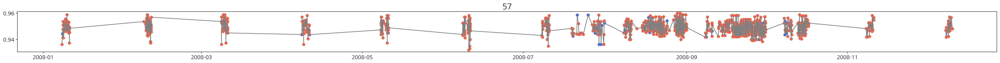

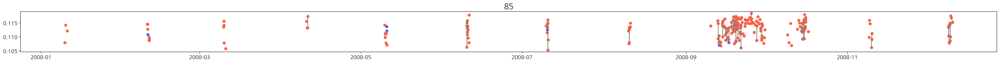

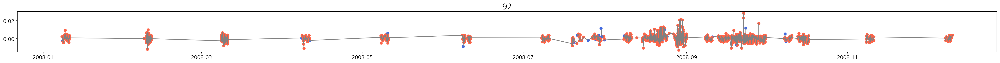

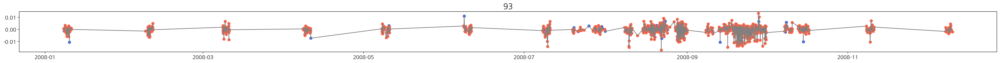

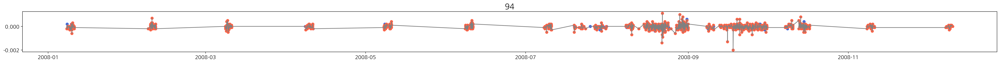

...

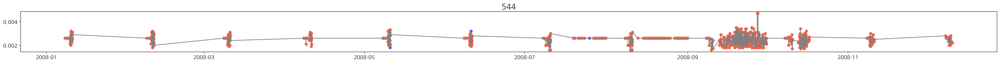

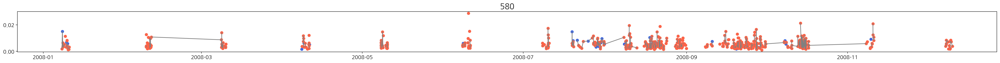

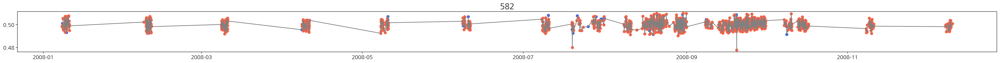

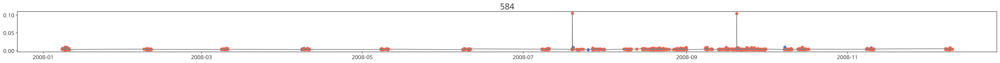

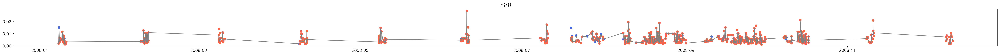

In [ ]:
# 표준편차가 0.005 이하인 값들 시각화
for idx, zc in enumerate(std_close_zero):
    plt.figure(figsize=(40, 2*len(std_close_zero)))
    plt.subplot(len(std_close_zero), 1, idx+1)
    data = df[[zc] + ["Time", "Target"]]

    plt.plot(data['Time'], data[zc], color='grey')
    plt.scatter(data[data['Target'] == 1]['Time'], data[data['Target'] == 1][zc], marker='o', color='royalblue')
    plt.scatter(data[data['Target'] == -1]['Time'], data[data['Target'] == -1][zc], marker='o', color='tomato')
    plt.title(f"{zc}")

plt.tight_layout()
plt.show()

### · Feature Engineering
---
* 머신러닝 모델의 성능을 향상시키기 위해 데이터의 특성(Feature)을 생성, 선택, 변환하는 과정
* 전처리 과정에서 진행한 Missing Value 및 Constant(상수) 제거도 Feature Engineering의 한부분


In [ ]:
# 상수 값, 결측치 50% 이상인 값, 표준편차가 0.005 이하인 값 제거
drop_columns = set()
for columns in [constant_cols, null_50, std_close_zero]:
    drop_columns.update(set(columns))

df_new = df.drop(columns=drop_columns)

In [ ]:
# 1567개의 row, 419개의 column
df_new.shape

(1567, 419)

In [ ]:
# 특정 구간에 동일한 값들이 많이 분포하기도 하고
# 이상치가 있는 값들이 많기 때문에 최빈값, 평균값으로 결측치 대치하기 힘듦
# mice 사용해 대치
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer

numeric_data = df_new.drop(columns=["Time", "Target",'month', 'day', 'hour', 'minute', 'season']).values

imputer_mice = IterativeImputer(random_state=42)
numeric_data = imputer_mice.fit_transform(numeric_data)

In [ ]:
# 결측치 대치
df_temp = df_new.drop(columns=["Time", "Target",'month', 'day', 'hour', 'minute', 'season'])
df_temp.loc[:, :] = numeric_data

In [ ]:
# 결측치 없음
for col in df_temp.columns:
    null_counts = df_temp[col].isnull().sum()
    if null_counts > 0:
        print(f"{col} column은 {null_counts}개의 결측치가 존재합니다.")

In [ ]:
# VIF를 이용해 다중공선성 있는 column 제거
from statsmodels.stats.outliers_influence import variance_inflation_factor

# VIF 계산
vif = [variance_inflation_factor(df_temp.values, i) for i in range(df_temp.shape[1])]

# VIF 값이 10 이상인 변수 추출
cols_to_drop = [col for col, vif in zip(df_temp.columns, vif) if vif >= 10]
df_temp = df_temp.drop(cols_to_drop, axis=1)

In [ ]:
# VIF 값이 10이상인 변수 추출 후 column 개수
# 1567개의 row와 46개의 변수
cols_to_drop, df_temp.shape

(373, (1567, 46))

### · Data Standardization
---
* 데이터 표준화를 통해 각 Feature를 동일한 수준에서 비교

In [ ]:
temp_columns = ["Time", "Target",'month', 'day', 'hour', 'minute', 'season']
feature_columns = df_temp.columns.to_list()

df_new = df_new[feature_columns + temp_columns]

In [ ]:
# 이상치가 존재하므로 중간값과 사분위를 활용한 RobustScaler() 사용
from sklearn.preprocessing import RobustScaler

rbs = RobustScaler()

features = df_new[feature_columns].values
target = df_new["Target"].values

scaled_features = rbs.fit_transform(features)
df_new.loc[:, feature_columns] = scaled_features

In [ ]:
df_new[feature_columns].describe().T

,count,mean,std,min,25%,50%,75%,max
9,1567.0,0.023934,0.786814,-2.713542,-0.494792,0.0,0.505208,3.968750
10,1567.0,-0.022342,0.808397,-3.069565,-0.521739,0.0,0.478261,4.573913
24,1567.0,-0.076503,1.017614,-5.165183,-0.488972,0.0,0.511028,4.976628
41,1567.0,0.338736,2.834072,-3.808827,-0.459492,0.0,0.540508,42.087062
59,1567.0,0.321450,1.523751,-4.793507,-0.450821,0.0,0.549179,26.777941
75,1567.0,-0.023155,0.848522,-3.777778,-0.503831,0.0,0.496169,9.111111
76,1567.0,-0.020064,0.741061,-3.546067,-0.515730,0.0,0.484270,2.262921
77,1567.0,0.066828,0.813209,-2.480418,-0.516971,0.0,0.483029,3.725849
78,1567.0,-0.021934,0.799993,-5.651808,-0.590412,0.0,0.409588,4.396972
79,1567.0,0.126566,0.975328,-2.434043,-0.472340,0.0,0.527660,4.293617


### · Model based Feature Selection
----


In [ ]:
from sklearn.model_selection import StratifiedKFold
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier

def calculate_iv(X, y):
    # 각 피처의 IV 계산
    iv_values = []
    for col in X.columns:
        bins = pd.qcut(X[col], q=10, duplicates='drop')  # Equal frequency binning
        df = pd.DataFrame({'feature': bins, 'target': y})
        grouped = df.groupby('feature')['target']
        good_rate = grouped.sum() / grouped.count()
        bad_rate = (grouped.count() - grouped.sum()) / grouped.count()
        iv = np.sum((good_rate - bad_rate) * np.log(good_rate / bad_rate))
        iv_values.append(iv)
    return iv_values

In [ ]:
# 로지스틱 회귀의 IV를 활용한 feature selection
# IV가 모두 0의 값을 가져 유의한 변수를 찾을 수 없었음
features = df_new[feature_columns]
target = df_new['Target']

iv_scores = calculate_iv(features, target)
selected_features = features.columns[np.argsort(iv_scores)[::-1]][:10]  # 상위 5개 피처 선택
X_selected = features[selected_features]
selected_features, iv_scores[:10]

(Index(['589', '81', '129', '108', '107', '102', '99', '98', '96', '91'], dtype='object'),
 [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0])

In [ ]:
# RandomForest를 활용한 feature selection
model = RandomForestClassifier(n_estimators=100, random_state=42)
model.fit(features, target)

RandomForestClassifier(random_state=42)

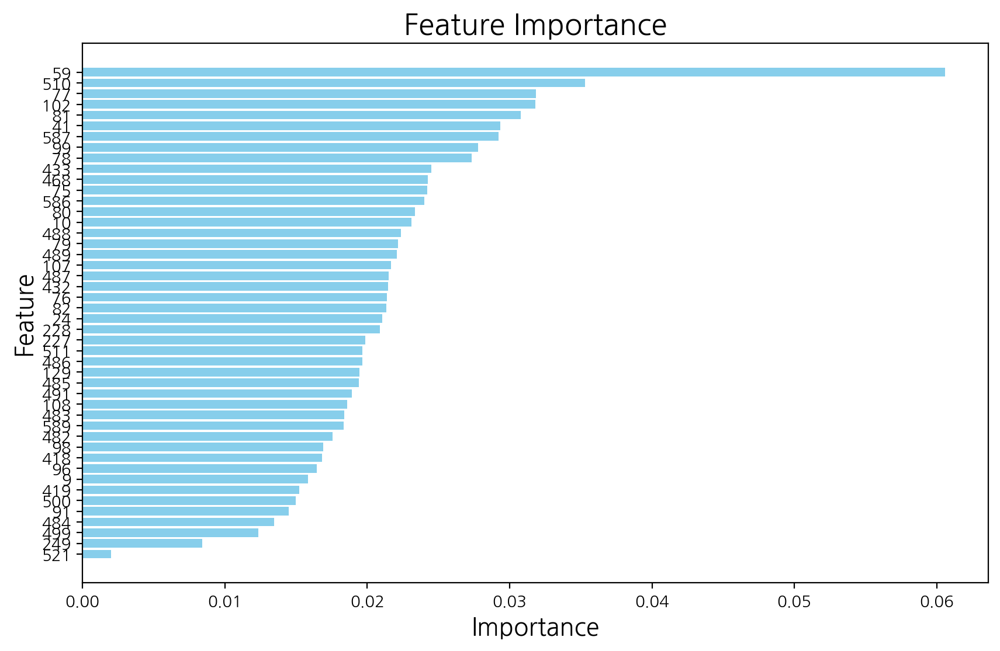

In [ ]:
feature_importance = pd.DataFrame({'Feature': features.columns, 'Importance': model.feature_importances_})
feature_importance = feature_importance.sort_values(by='Importance', ascending=False)

plt.figure(figsize=(10, 6))
plt.barh(feature_importance['Feature'], feature_importance['Importance'], color='skyblue')
plt.xlabel('Importance')
plt.ylabel('Feature')
plt.title('Feature Importance')
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)
plt.gca().invert_yaxis()
plt.show()

In [ ]:
# Importance의 값이 낮긴 하지만, 0.02를 넘는 feature의 개수는 25개
len(feature_importance[feature_importance["Importance"] > 0.02]['Feature'])

25

## **🍁 Data Analysis 3단계**  
**┗ 이상탐지(분류) 및 모델링**  
---

```
'Class' 이상여부를 판단할 수 있는 ML알고리즘 학습/예측 평가
"Q. 어떻게 Class가 1인 데이터를 추출할 수 있을까?"

※ 수강생 학습 및 적용해야하는 사항 (*추가 학습 자료 활용)
 - 이상탐지 개념 및 목적 이해
 - 머신러닝 개념 및 분석 코드 이해
 - 이상탐지(Anomaly Detection) 및 분류(Classification) 알고리즘 이해
 - "여러 알고리즘 중 왜 해당 알고리즘을 사용했는가?"에 대한 답변도 준비하면 좋음
 - Feature Selection / Feature Extraction 개념 이해 및 적용해보기
```  

### · Modeling
---
> **데이터 사전 준비**

```
* 모델은 숫자로 이루어진 형태의 Data만 인식 가능 (※ 문자형 변수 인코딩 필요)
* 모델링을 수행하기 위해 Feature와 예측하고자하는 값인 Y로 데이터를 나눔
* 학습과 예측을 위한 Train / Test set 분할
* Categorical value 인코딩
```
> **Model Selection (classification)**

```
* 로지스틱 모델 (logistic regression)
* Tree 계열 Classification 모델
  - bagging 앙상블 (Randomforest)
  - boosting 앙상블 (lightGBM)
```
> **Model 학습**

```
* Model Selection 단계에서 선정한 모델들을 학습하고 성능을 기록
* 동일한 Data set, 동일한 환경에서 동일한 비교 지표로 성능을 비교
```

In [ ]:
!pip install pyod

In [ ]:
import time

from sklearn.model_selection import cross_validate, StratifiedKFold, train_test_split
from sklearn.metrics import make_scorer, f1_score, roc_auc_score, recall_score, precision_score, average_precision_score, classification_report

from sklearn.ensemble import IsolationForest
from pyod.models.xgbod import XGBOD


skf = StratifiedKFold(5, shuffle = True, random_state = 42)

In [ ]:
# 46개의 columns을 이용해 모델에 적합했을 때랑
# model-based feature selection을 활용한 25개의 feature를 가지고 모델을 적합했을 때를 비교

X = df_new[feature_columns]
y = df_new['Target']

rf_cols = feature_importance[feature_importance["Importance"] > 0.02]['Feature']
X1 = df_new[rf_cols]

contamination = y.value_counts(normalize=True).loc[1]

In [ ]:
def model_evaluation(X, y, model):
    # StratifiedKFold 객체 생성
    skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

    # 사용할 평가 지표 설정
    scoring = {'f1': 'f1',
            'roc_auc': 'roc_auc',
            'recall': make_scorer(recall_score),
            'precision': make_scorer(precision_score),
            'average_precision': 'average_precision'}

    # cross_val_score를 사용하여 각 폴드에서 평가 지표 계산
    scores = cross_validate(model, X, y, cv=skf, scoring=scoring)

    return scores

#### IsolationForest

In [ ]:
# 46개의 column 사용
model = IsolationForest(contamination=contamination, random_state=42)
scores = model_evaluation(X, y, model)

print("IsolationForest")
print("평균 F1 Score:", scores['test_f1'].mean())
print("평균 ROC AUC Score:", scores['test_roc_auc'].mean())
print("평균 Recall Score:", scores['test_recall'].mean())
print("평균 Precision Score:", scores['test_precision'].mean())
print("평균 Average Precision Score:", scores['test_average_precision'].mean())

IsolationForest
평균 F1 Score: 0.12106423248705
평균 ROC AUC Score: 0.4543824484770765
평균 Recall Score: 0.9138095238095237
평균 Precision Score: 0.0648295484981222
평균 Average Precision Score: 0.06539257177711974


In [ ]:
# 25개 column 사용
# 46개의 column 사용 했을 때가 더 좋은 결과를 나타냄
model = IsolationForest(contamination=contamination, random_state=42)
scores = model_evaluation(X1, y, model)

print("IsolationForest")
print("평균 F1 Score:", scores['test_f1'].mean())
print("평균 ROC AUC Score:", scores['test_roc_auc'].mean())
print("평균 Recall Score:", scores['test_recall'].mean())
print("평균 Precision Score:", scores['test_precision'].mean())
print("평균 Average Precision Score:", scores['test_average_precision'].mean())

IsolationForest
평균 F1 Score: 0.11390293541064714
평균 ROC AUC Score: 0.37259287706854216
평균 Recall Score: 0.8557142857142856
평균 Precision Score: 0.06101752300554131
평균 Average Precision Score: 0.05880486844522824


In [ ]:
# 46개의 columns을 이용해 confusion matrix 확인
start = time.time()
model = IsolationForest(contamination=contamination, random_state=42)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, stratify=y, random_state=42)

model.fit(X_train)
print(time.time() - start)
y_pred = model.predict(X_test)

0.8877377510070801


In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

          -1       0.94      0.05      0.10       293
           1       0.07      0.95      0.13        21

    accuracy                           0.11       314
   macro avg       0.50      0.50      0.11       314
weighted avg       0.88      0.11      0.10       314



#### XGBOD

In [ ]:
# 46개의 column 사용
model = XGBOD(random_state=42)
target = y.apply(lambda x: 0 if x < 0 else 1)
scores = model_evaluation(X, target, model)

print("XGBOD")
print("평균 F1 Score:", scores['test_f1'].mean())
print("평균 ROC AUC Score:", scores['test_roc_auc'].mean())
print("평균 Recall Score:", scores['test_recall'].mean())
print("평균 Precision Score:", scores['test_precision'].mean())
print("평균 Average Precision Score:", scores['test_average_precision'].mean())

XGBOD
평균 F1 Score: 0.019047619047619046
평균 ROC AUC Score: 0.6962629878731612
평균 Recall Score: 0.01
평균 Precision Score: 0.2
평균 Average Precision Score: 0.15988243476238764


In [ ]:
# 25의 column 사용
model = XGBOD(random_state=42)
scores = model_evaluation(X1, target, model)

print("XGBOD")
print("평균 F1 Score:", scores['test_f1'].mean())
print("평균 ROC AUC Score:", scores['test_roc_auc'].mean())
print("평균 Recall Score:", scores['test_recall'].mean())
print("평균 Precision Score:", scores['test_precision'].mean())
print("평균 Average Precision Score:", scores['test_average_precision'].mean())

XGBOD
평균 F1 Score: 0.03722943722943722
평균 ROC AUC Score: 0.663607172356062
평균 Recall Score: 0.019523809523809523
평균 Precision Score: 0.4
평균 Average Precision Score: 0.15974784794125896


In [ ]:
start = time.time()
model = XGBOD(random_state=42)
X_train, X_test, y_train, y_test = train_test_split(X1, target, test_size=0.2, stratify=target, random_state=42)

model.fit(X_train, y_train)
print(time.time()- start)
y_pred = model.predict(X_test)

11.421315431594849


In [ ]:
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.93      0.99      0.96       293
           1       0.00      0.00      0.00        21

    accuracy                           0.93       314
   macro avg       0.47      0.50      0.48       314
weighted avg       0.87      0.93      0.90       314



## **⛄ Data Analysis 4단계**  
**┗ 해석 및 결론**  
---

### · 결론 및 기대효과
---
> 결론

```
▶  결론
    - IsolationForest의 경우 Recall이 높지만, Precision이 낮은 경향이 있었음.
        - Fail의 경우도 Pass로 오판하는 경우가 많았음.
    - XGBOD의 경우 거의 모든 값들을 Fail로 예측하는 경향이 있었음.
        - IsolationForest 보다 보수적인 결론을 내는 경향이 많았음.
    - 두 모델의 시간차이를 확인해 보면, 전자의 경우 0.88초, 후자의 경우 11.42초
        - 모델 학습에 걸리는 시간 측면에서는 IsolationForest를 활용하는 것이 좋아보임.
        - 하지만, 많은 값들을 양품으로 예측해 성능적으론 좋지 못함.    
```


> 향후 계획

```
▶  향후 계획
    - 공정 이상을 탐지하는 정확한 column들을 분리해 낼 필요가 있음
        - 공정의 베테랑 전문가들과의 상의를 통해 이상치 제거 여부를 파악해야함.
    - 데이터를 초단위로 획득하여 좀 더 정밀한 예측을 할 수 있도록 파악
    - parameter tuning을 활용한 모델 성능 향상
    - 주기적으로 데이터 획득 후, 월마다 모델 parameter tuning 진행
    - 기존 모델과 현 모델의 공정 불량률 차이를 확인
```

> 기대효과

```
▶ 기대 효과
    - 사전에 공정의 이상을 탐지하여 재작업 및 폐기 비용 수십억원 감소
    - 생산 공정 최적화 및 설비 활용도 향상
```